# Python notebook for RNA velocity experiments with scVelo and DynamicViz (Figure 4)

https://doi.org/10.1101/2022.05.27.493785

In [1]:
import sys
import scvelo as scv
import scanpy as sc
import cellrank as cr

scv.settings.verbosity = 3
scv.settings.set_figure_params("scvelo")

import warnings

warnings.simplefilter("ignore", category=UserWarning)
warnings.simplefilter("ignore", category=FutureWarning)
warnings.simplefilter("ignore", category=DeprecationWarning)

import anndata as ad

from dynamicviz.dynamicviz import boot, viz, score, utils
import numpy as np
import pandas as pd
import seaborn as sns#; sns.set()
import matplotlib.pyplot as plt
from scipy.ndimage.filters import gaussian_filter1d
import pickle

In [3]:
# load data
adata = scv.datasets.pancreas()
adata

AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score'
    var: 'highly_variable_genes'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_umap'
    layers: 'spliced', 'unspliced'
    obsp: 'distances', 'connectivities'

In [3]:
# preprocess data
scv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)

Filtered out 20801 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [4]:
# compute RNA velocity
scv.tl.velocity(adata)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [5]:
# compute velocity graph
scv.tl.velocity_graph(adata)

computing velocity graph (using 1/16 cores)
or disable the progress bar using `show_progress_bar=False`.
    finished (0:00:08) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [6]:
#adata.write("adata.h5ad")
adata

AnnData object with n_obs × n_vars = 3696 × 2000
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition'
    var: 'highly_variable_genes', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca', 'velocity_params', 'velocity_graph', 'velocity_graph_neg'
    obsm: 'X_pca', 'X_umap'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velocity', 'variance_velocity'
    obsp: 'distances', 'connectivities'

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


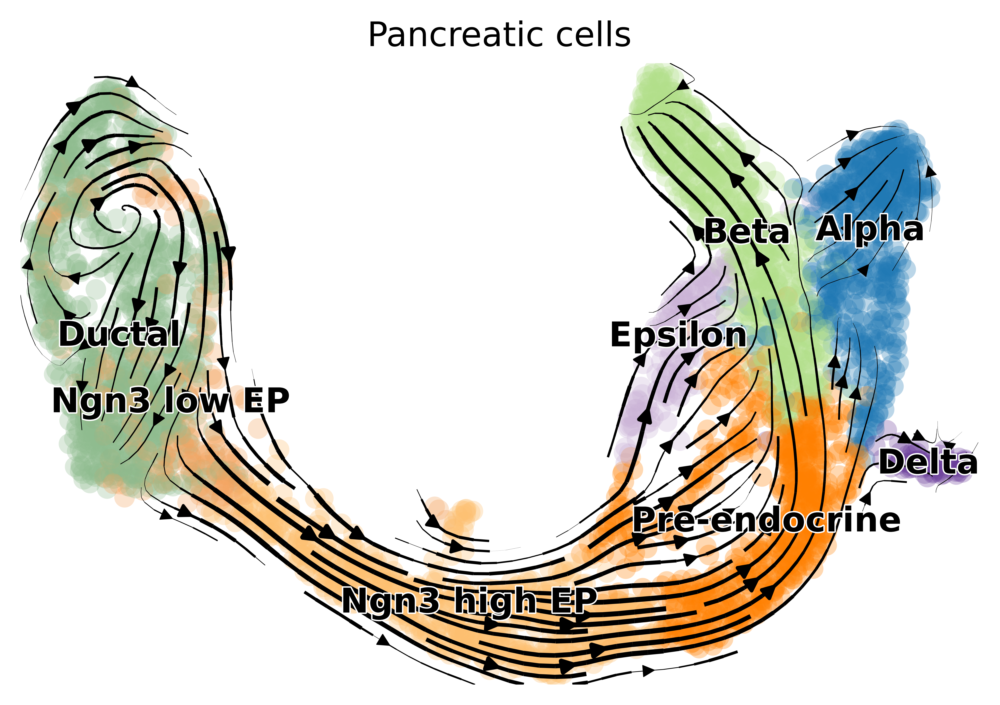

In [7]:
scv.pl.velocity_embedding_stream(adata, basis='umap', dpi=500, title="Pancreatic cells")

In [46]:
# retrieve relevant X and Y from adata
X, Y = utils.convert_anndata(adata, obs=["clusters"])

In [47]:
# generate bootstrap visualizations
out = boot.generate(X, Y=Y, method="umap", B=50, save="tests/outputs/rna_velo.csv", random_seed=452)

100%|███████████████████████████████████████████████████████████████████████████████████| 50/50 [05:15<00:00,  6.31s/it]


## Figure 4B: Compute variance scores

In [91]:
stability_scores = score.stability(out, method="random", k=50, alpha=20, normalize_pairwise_distance=False)

Setting up neighborhoods...
--- 0.09414410591125488 seconds ---
Populating distances...
--- 70.28768706321716 seconds ---
Computing mean pairwise distance for normalization...
--- 3.7777645587921143 seconds ---
Computing variance scores...
--- 7.442117929458618 seconds ---
Computing stability score with alpha=20 ...
--- 0.0004749298095703125 seconds ---


In [93]:
variance_scores = -1*(1-(1/stability_scores)**(1/20))

In [94]:
#np.savetxt("tests/outputs/stability_scores.txt", stability_scores)
#np.savetxt("tests/outputs/variance_scores.txt", variance_scores)

In [5]:
#adata.obs["Stability Score"] = stability_scores
adata.obs["Variance Score"] = variance_scores

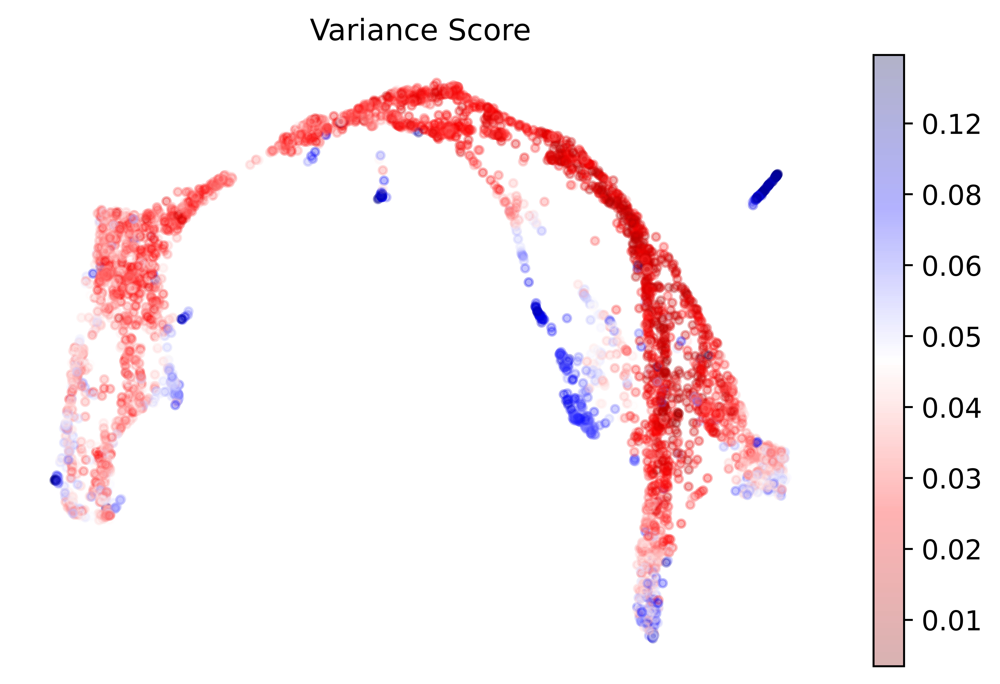

In [36]:
with plt.rc_context({"figure.dpi": (500)}):
#    fig = sc.pl.umap(adata, color="Stability Score", cmap='seismic', s=50, alpha=0.3)
    fig, ax = plt.subplots()
    plt.scatter(adata.obsm["X_umap"][:,0], adata.obsm["X_umap"][:,1],
                c=adata.obs["Stability Score"], cmap='seismic', s=10, alpha=0.3)
    ax.axis('off')
    cbar = plt.colorbar()
    cbar.ax.invert_yaxis()
    stabilities = cbar.get_ticks()
    cbar.ax.set_yticklabels(["%.2f" % (-1*(1-(1/float(s))**(1/20))) for s in stabilities])
    plt.title("Variance Score")
    plt.tight_layout()
    plt.savefig("plots/rna_velocity/stability_score.pdf")
    plt.savefig("figures/Figure4/stability_score.png", dpi=500, bbox_inches='tight')
    plt.show()

# Load results

In [3]:
adata = ad.read_h5ad("adata.h5ad")
out = pd.read_csv("tests/outputs/rna_velo.csv")
variance_scores = np.genfromtxt("tests/outputs/variance_scores.txt")

adata = utils.regenerate_anndata(adata, out, -1, "X_umap")
if "velocity_umap" in list(adata.obsm.keys()):
    del adata.obsm["velocity_umap"]

## Figure 4A: Save a few bootstrapped velocity streams

-1
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


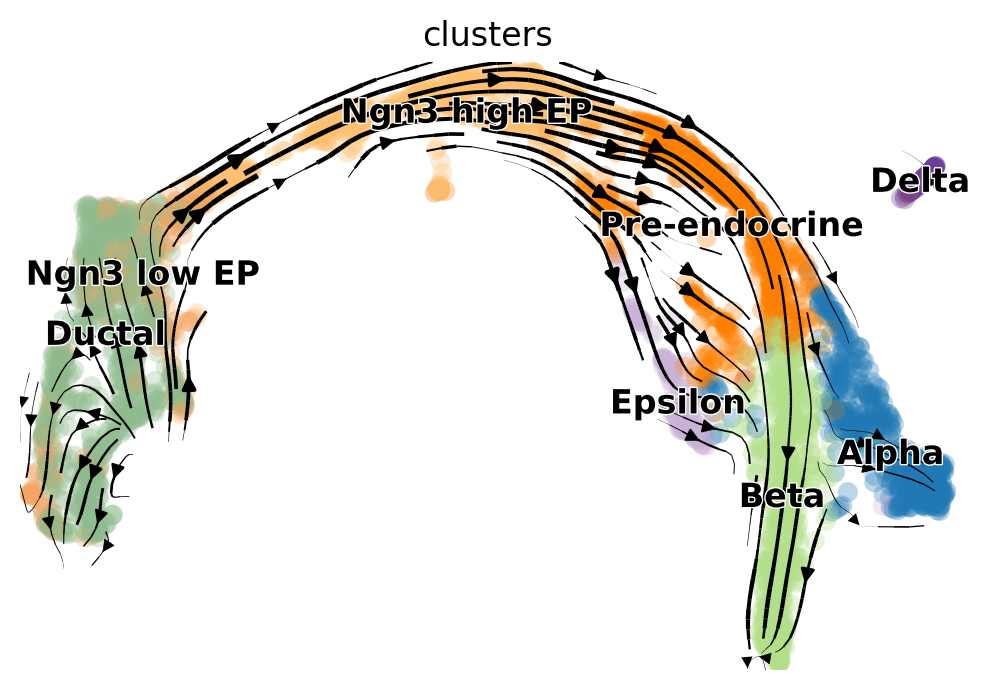

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


0
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


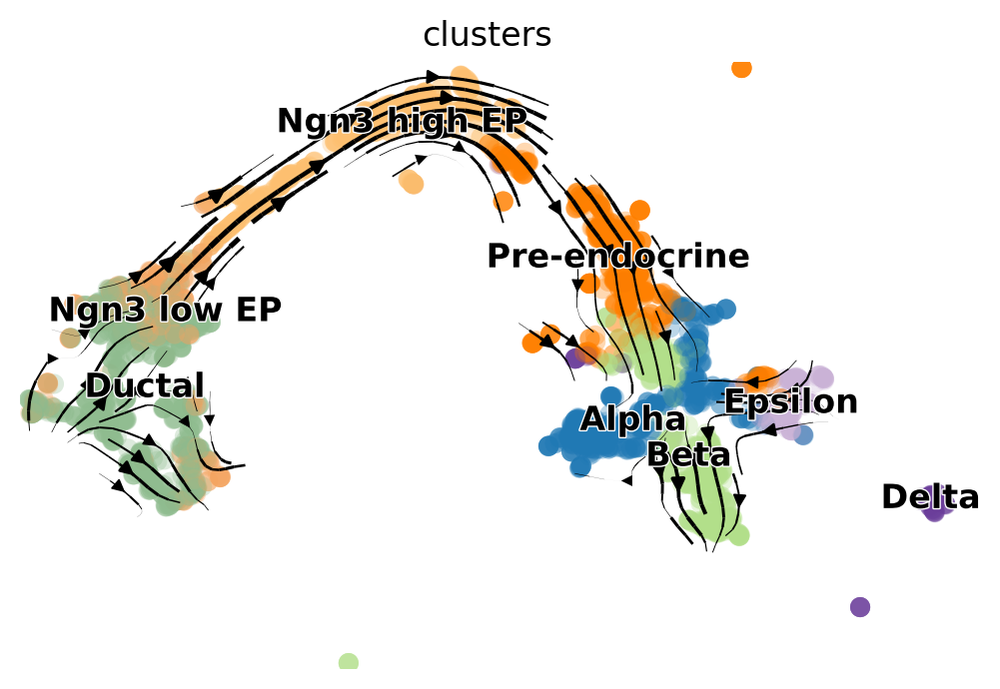

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


1
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


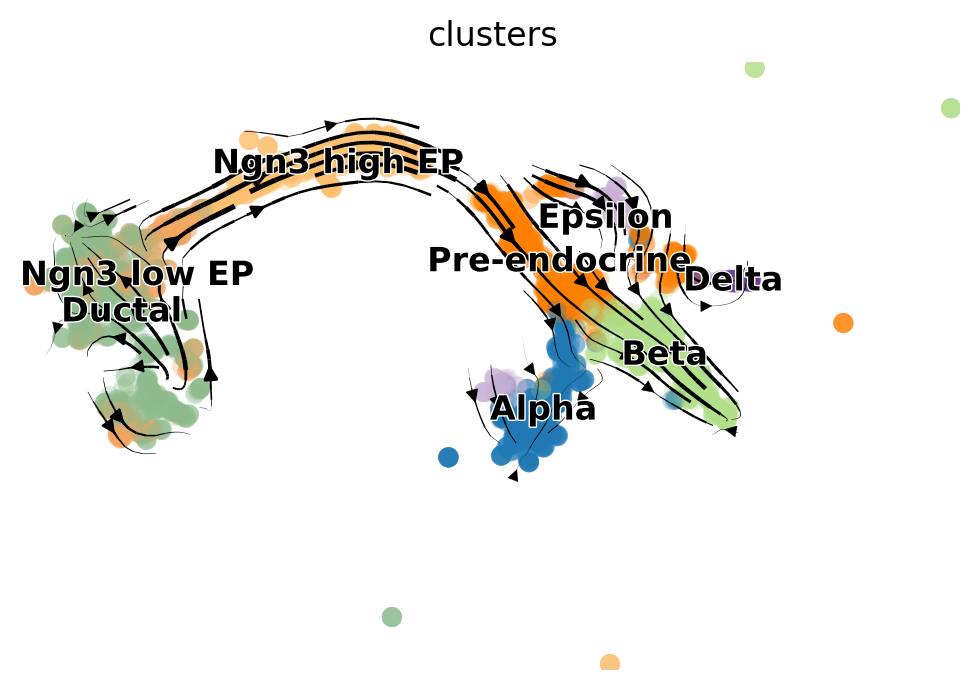

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


2
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


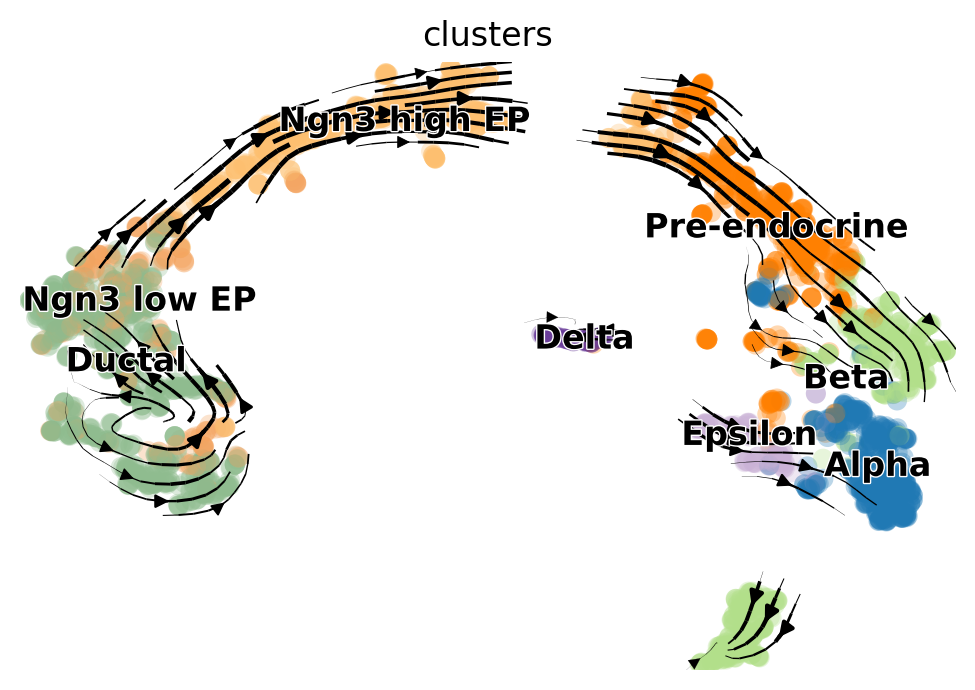

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


3
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


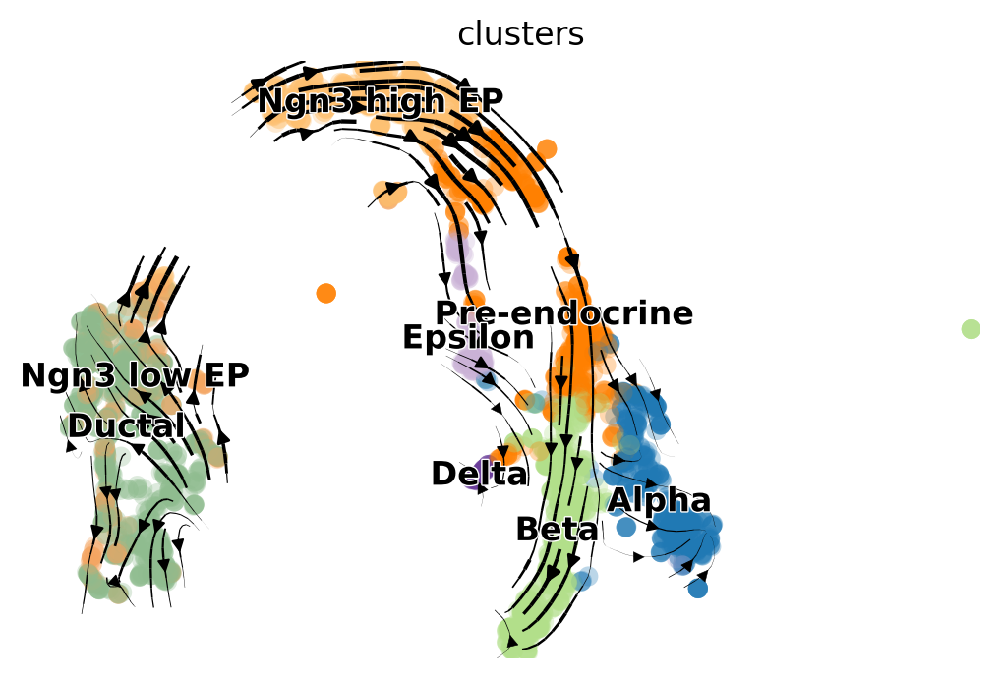

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


4
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


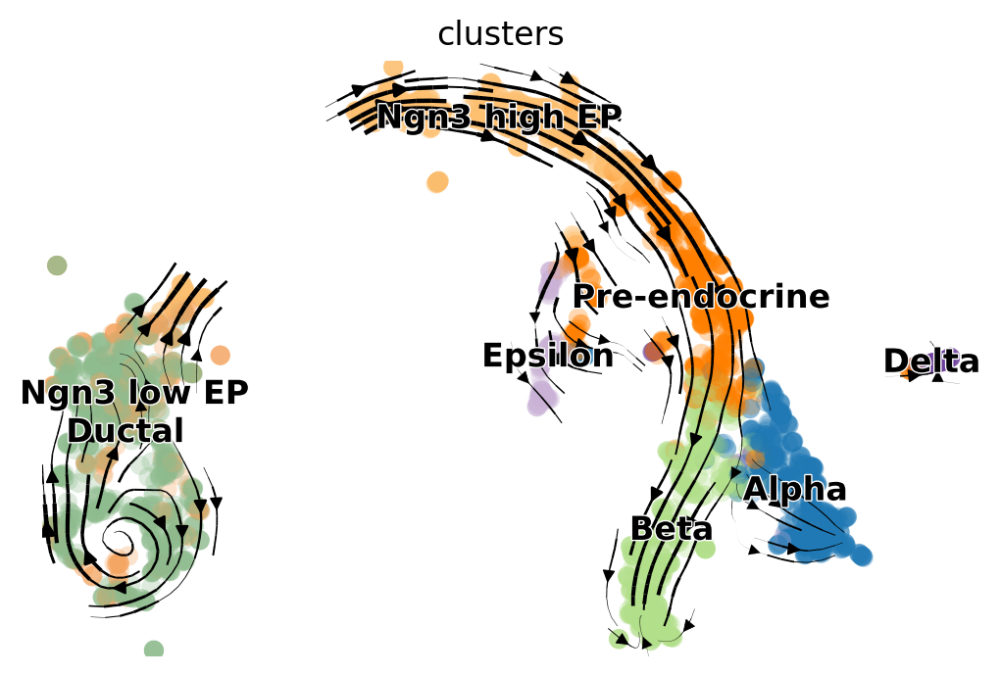

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


5
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


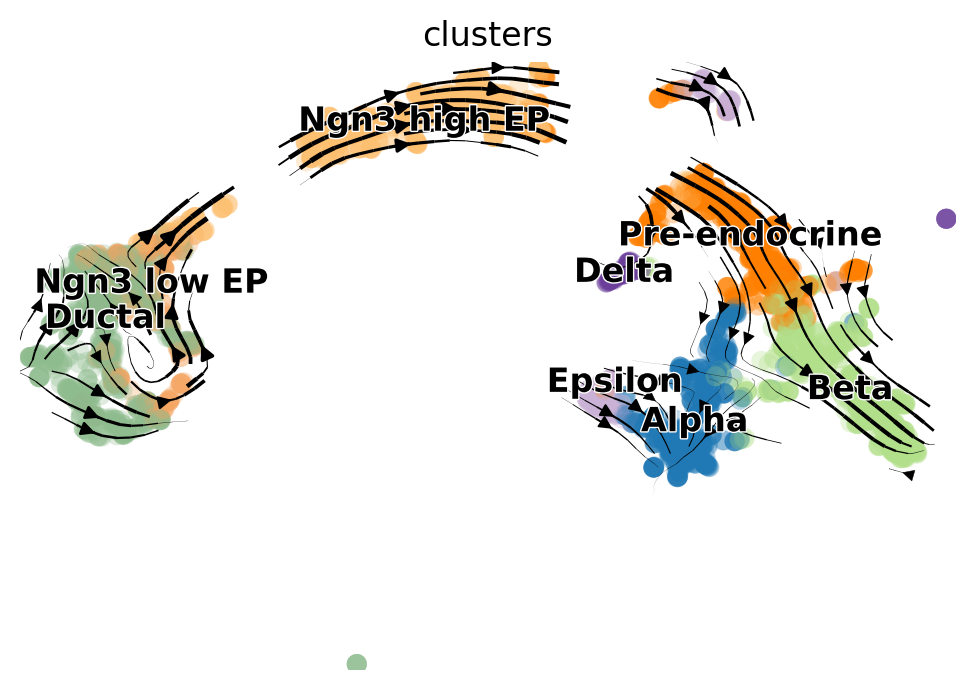

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


6
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


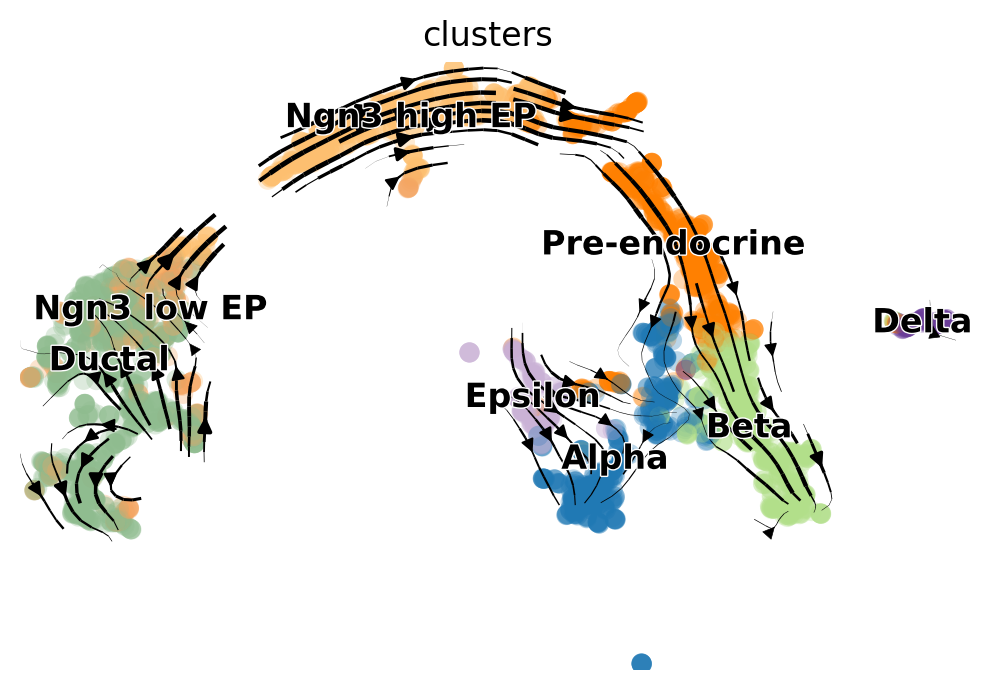

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


7
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


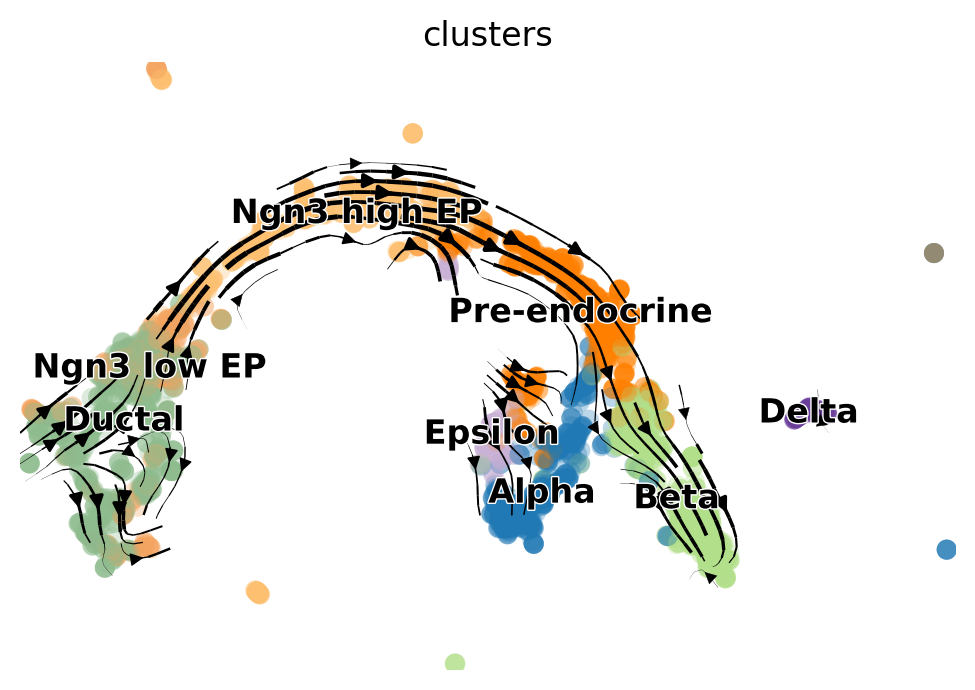

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


8
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


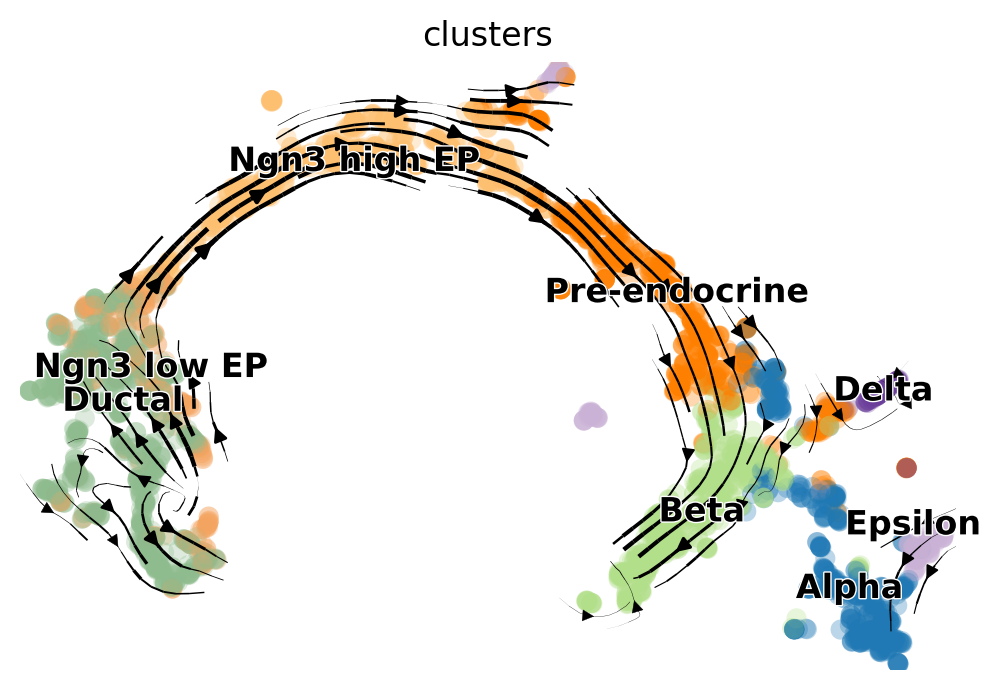

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


9
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


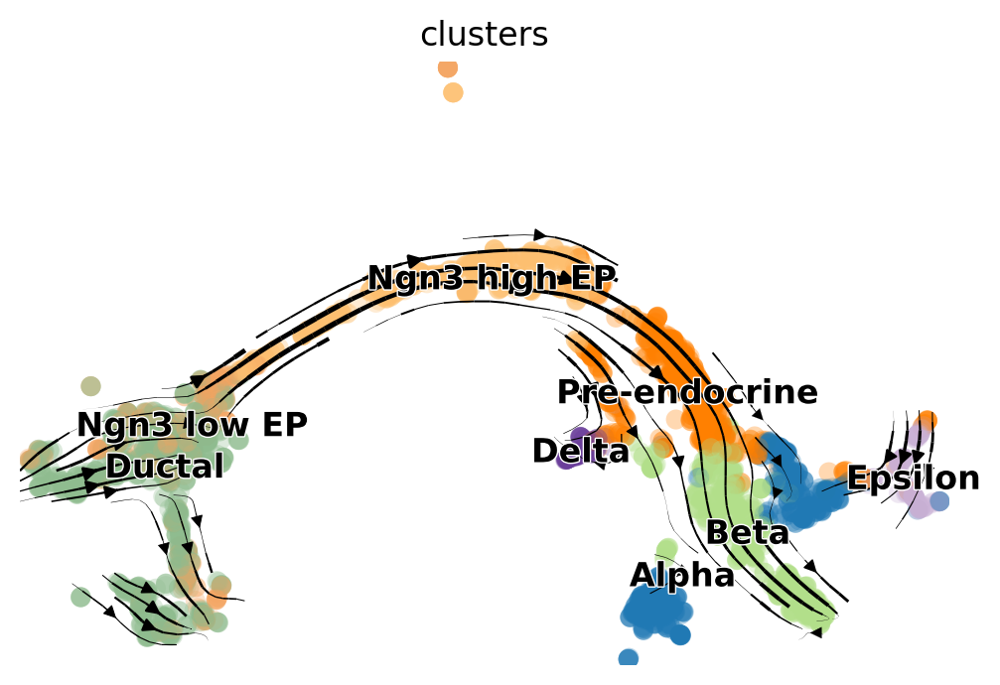

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


10
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


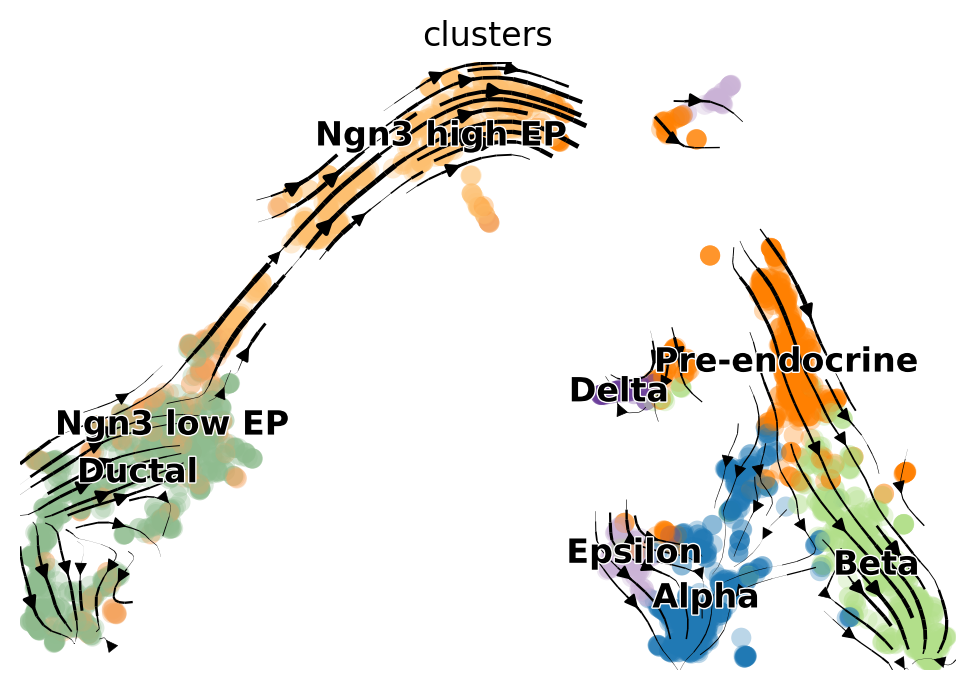

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


11
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


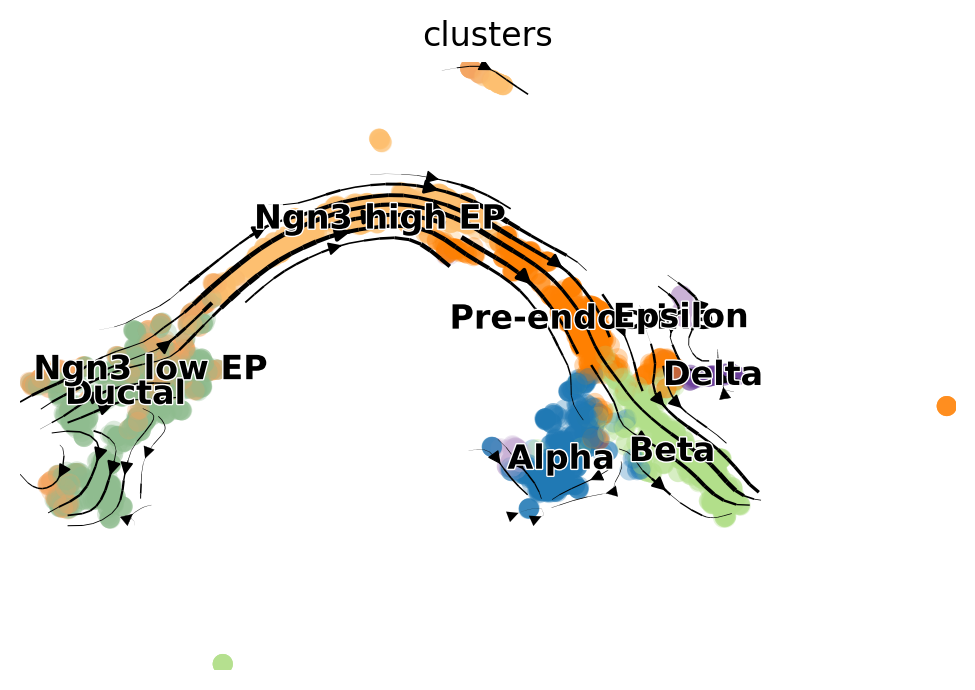

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


12
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


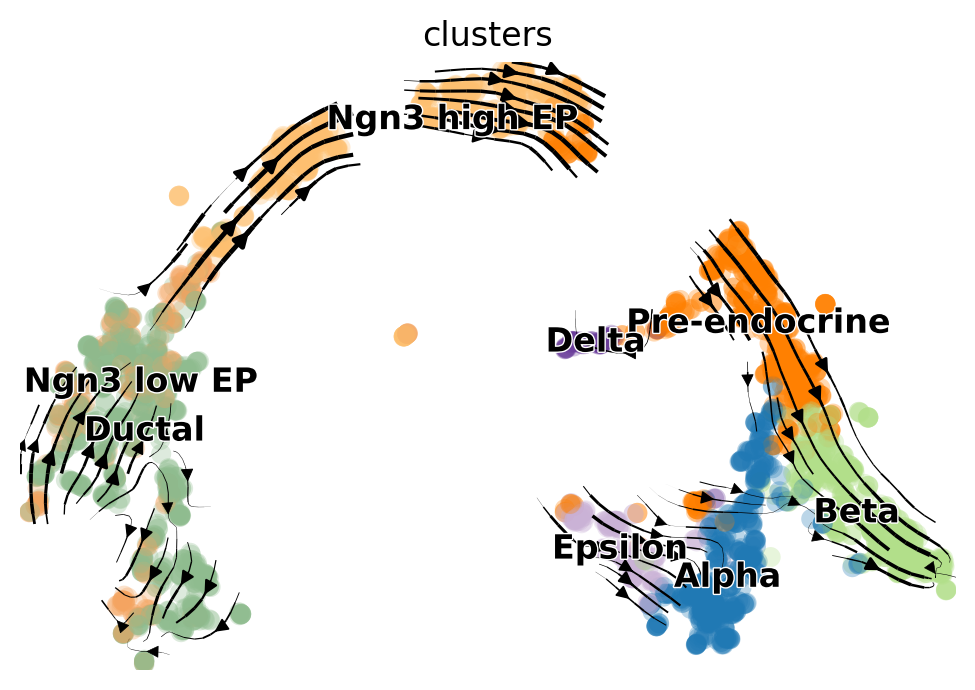

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


13
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


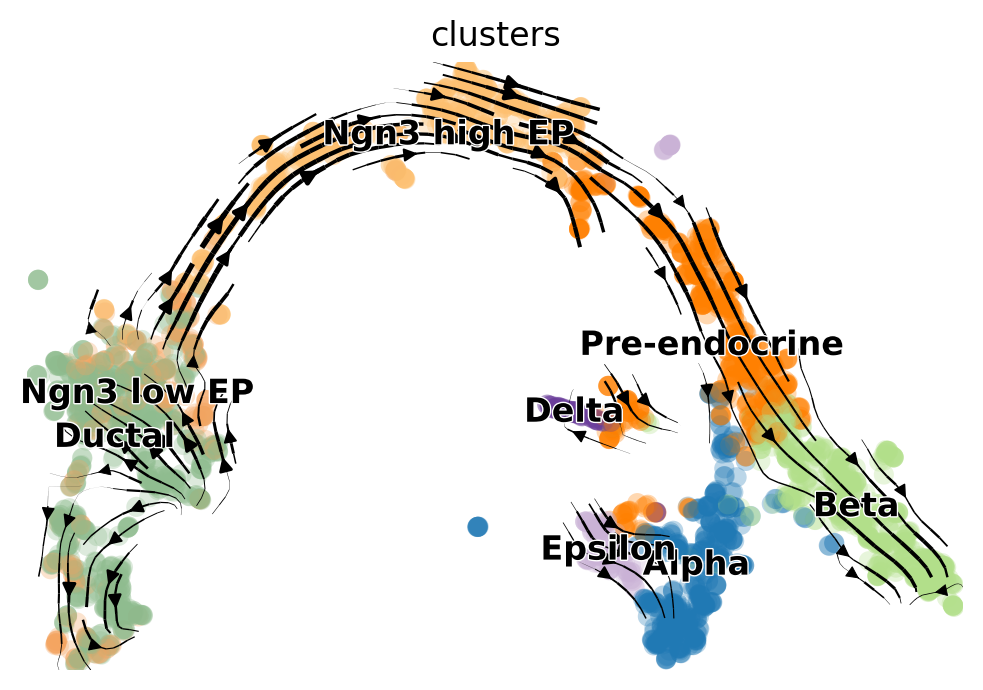

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


14
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


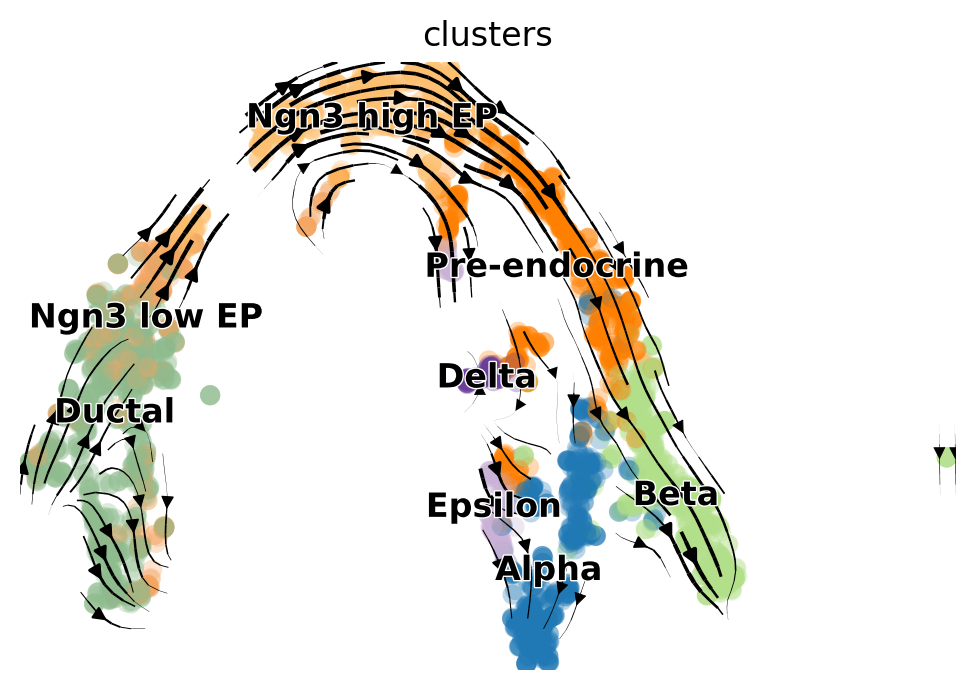

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


15
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


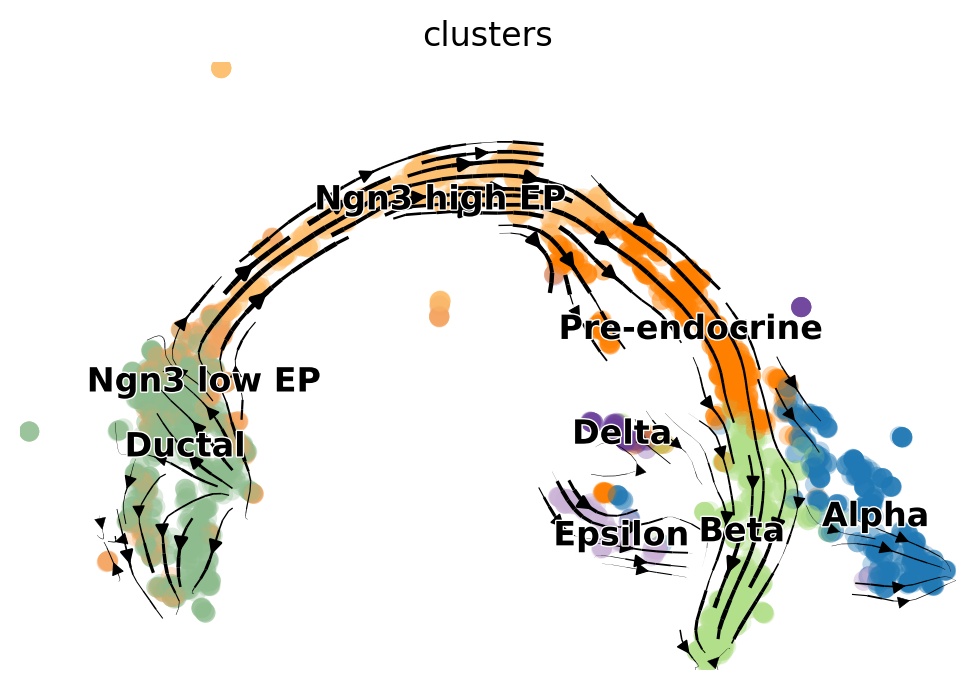

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


16
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


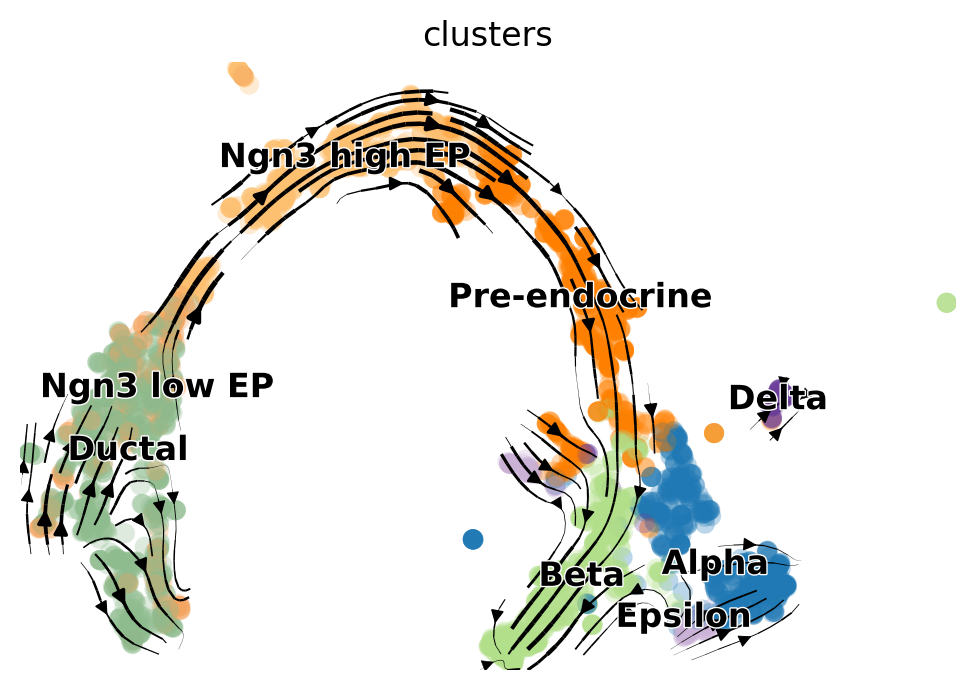

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


17
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


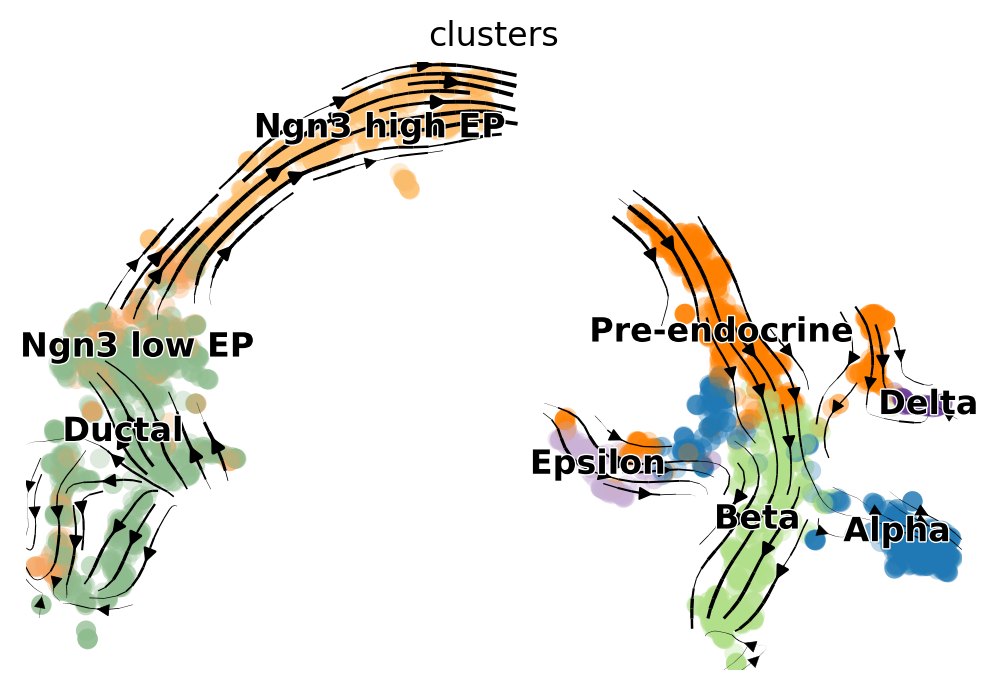

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


18
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


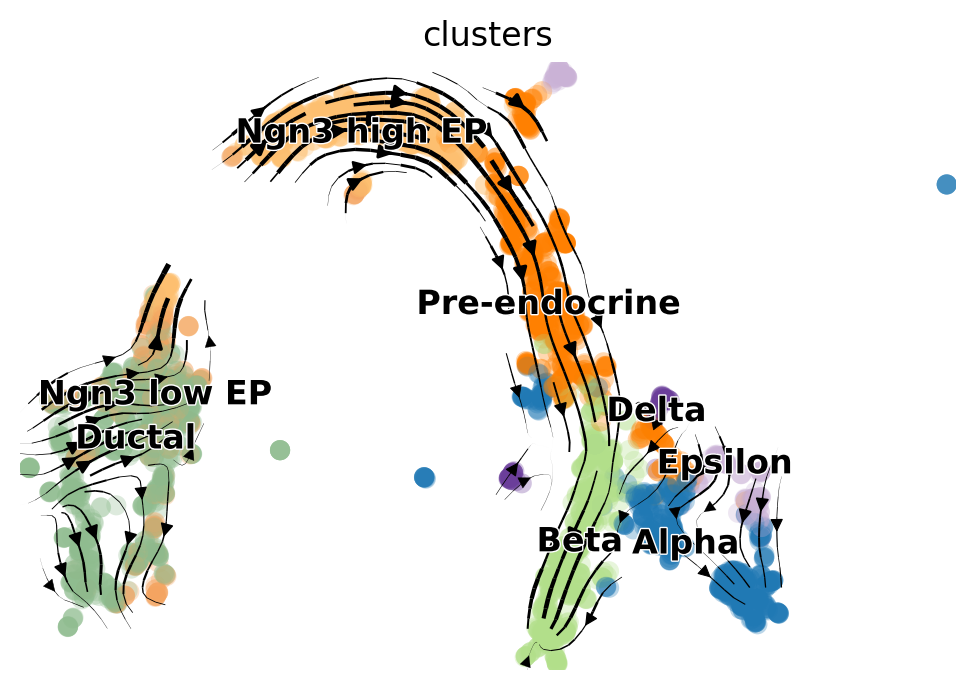

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


19
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


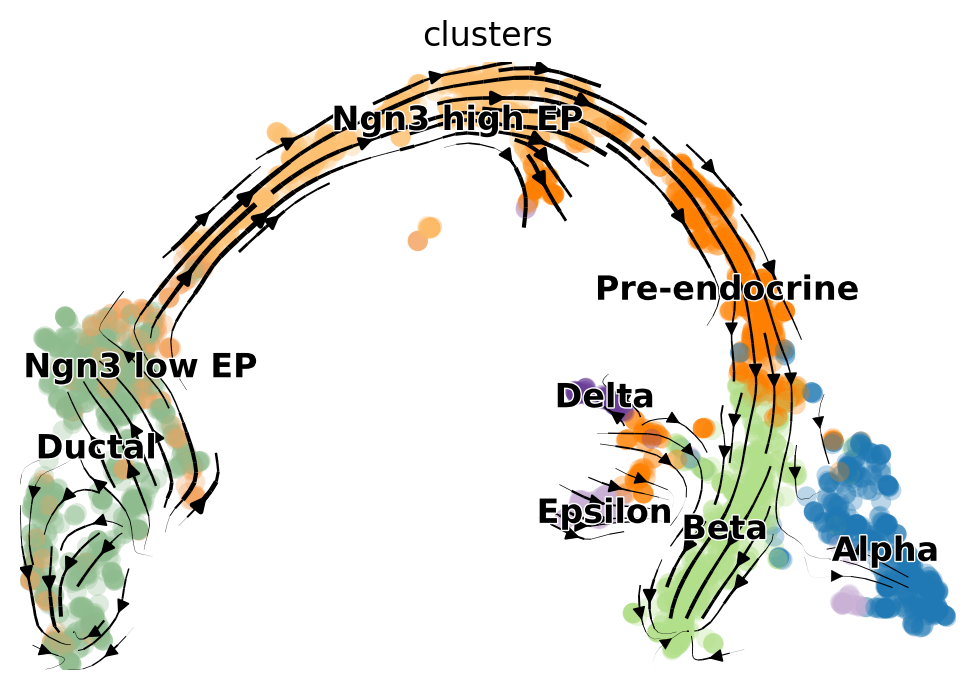

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


20
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


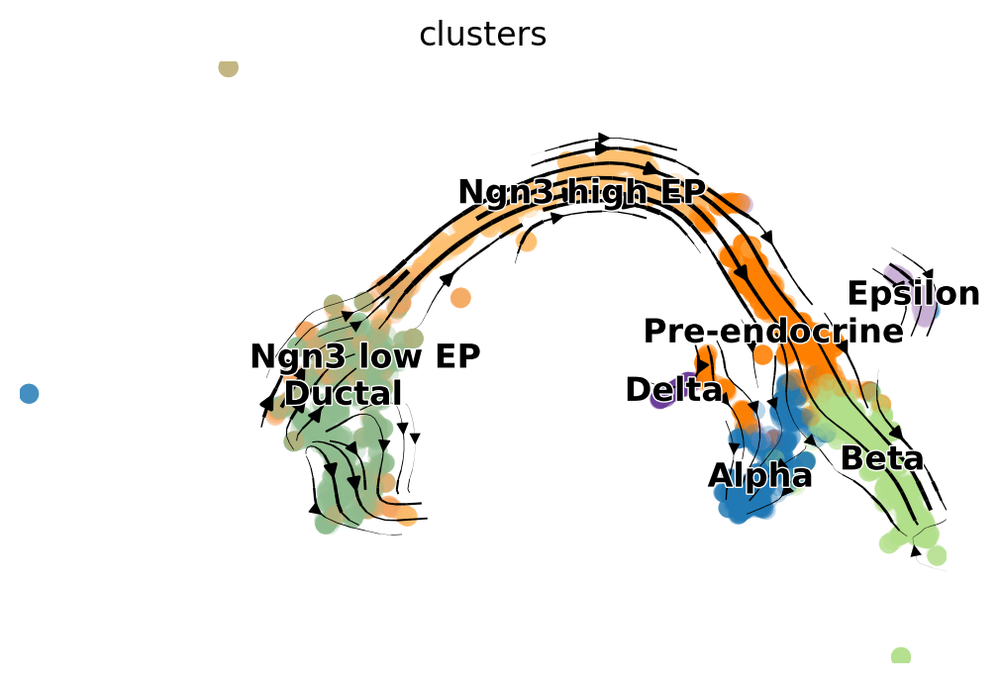

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


21
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


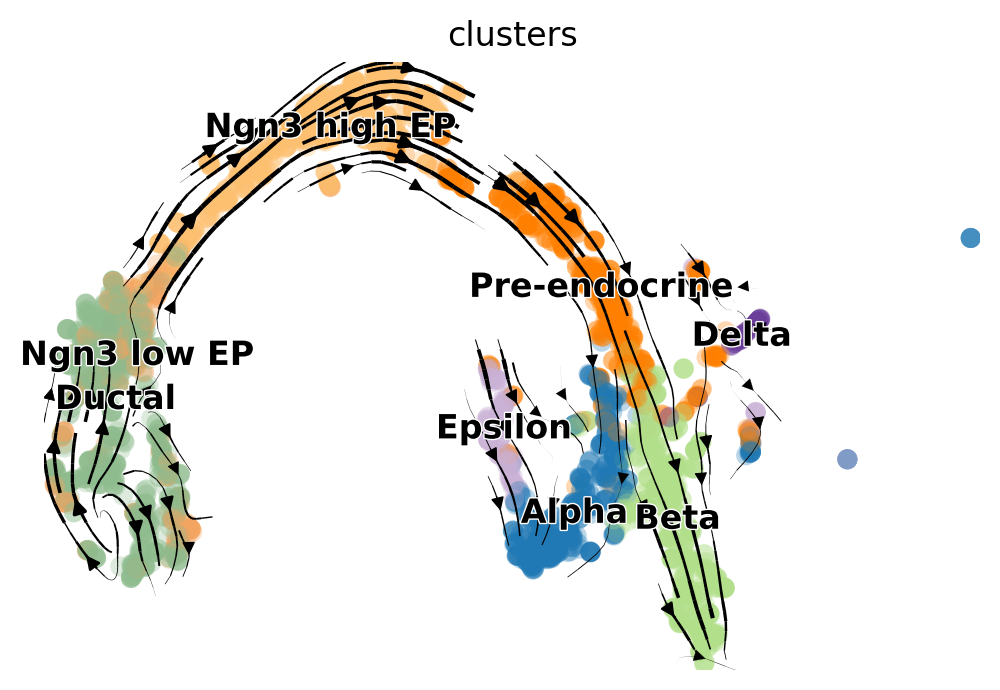

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


22
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


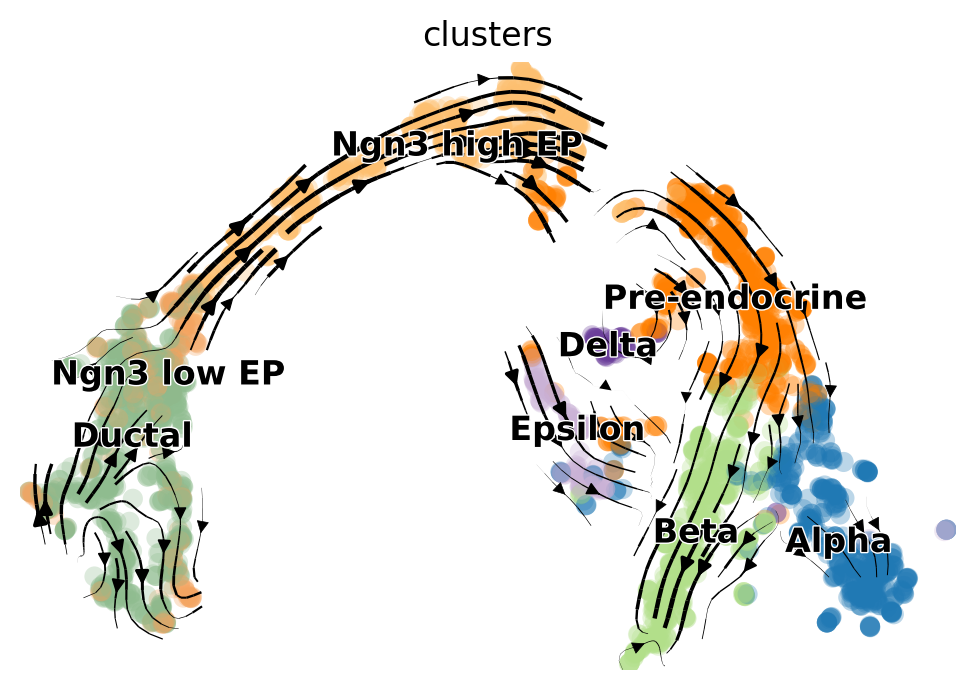

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


23
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


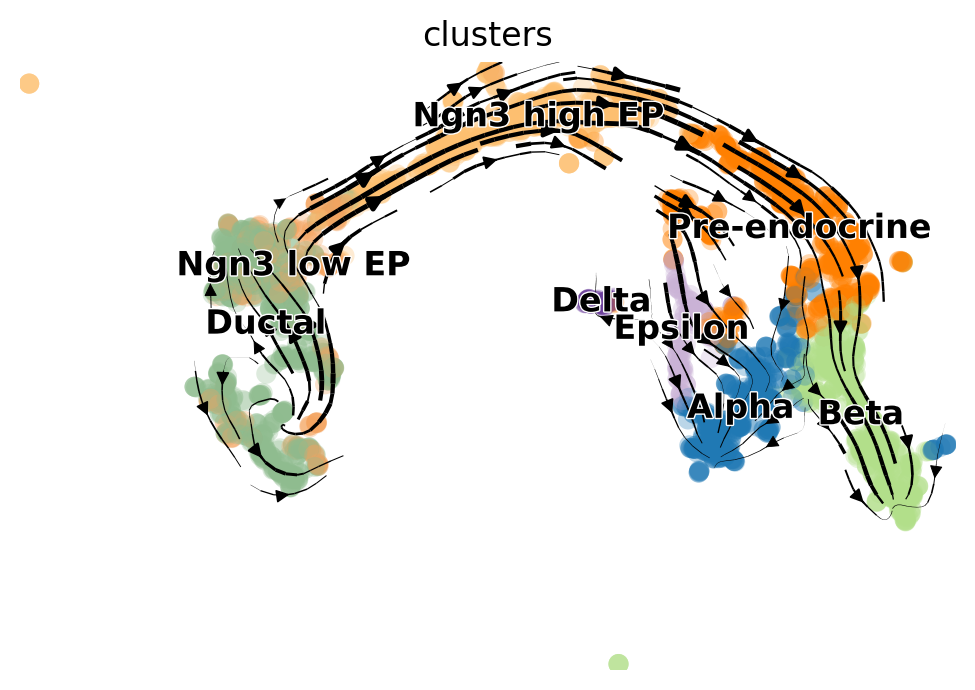

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


24
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


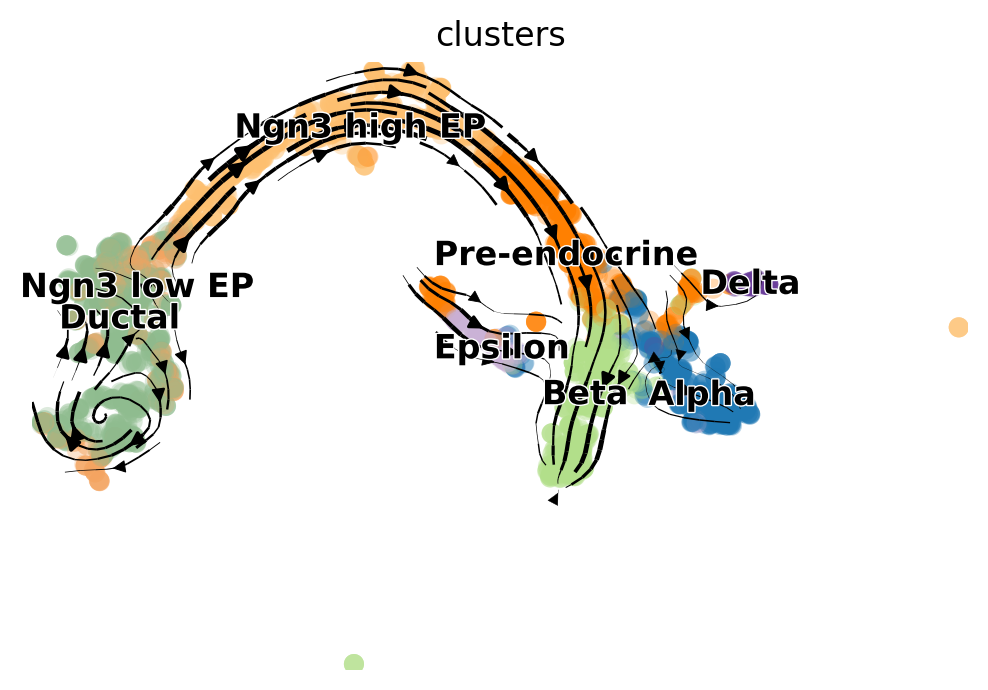

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


25
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


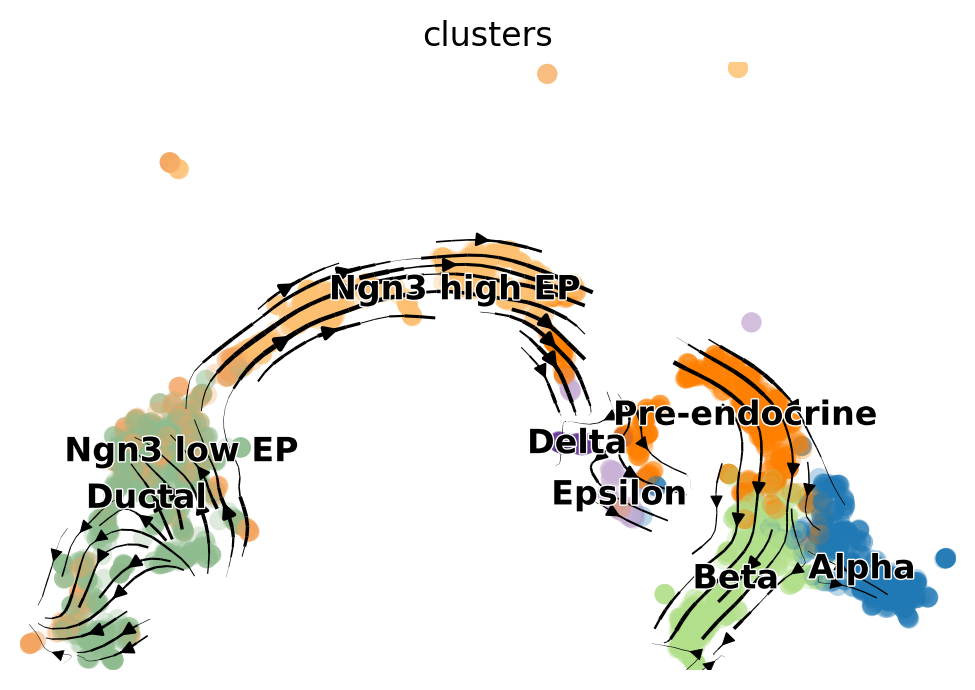

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


26
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


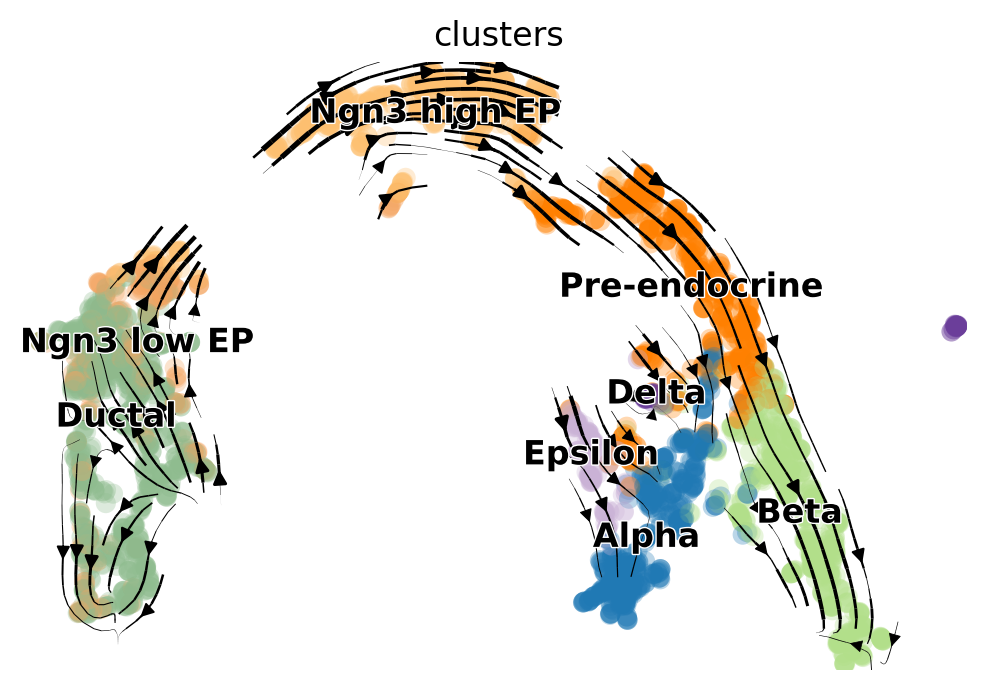

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


27
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


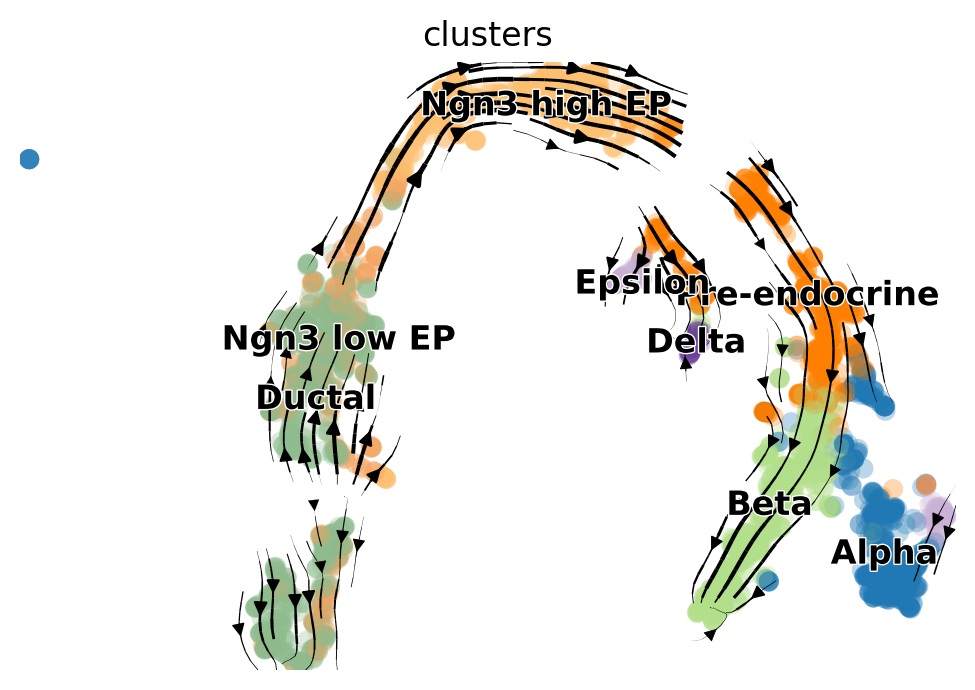

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


28
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


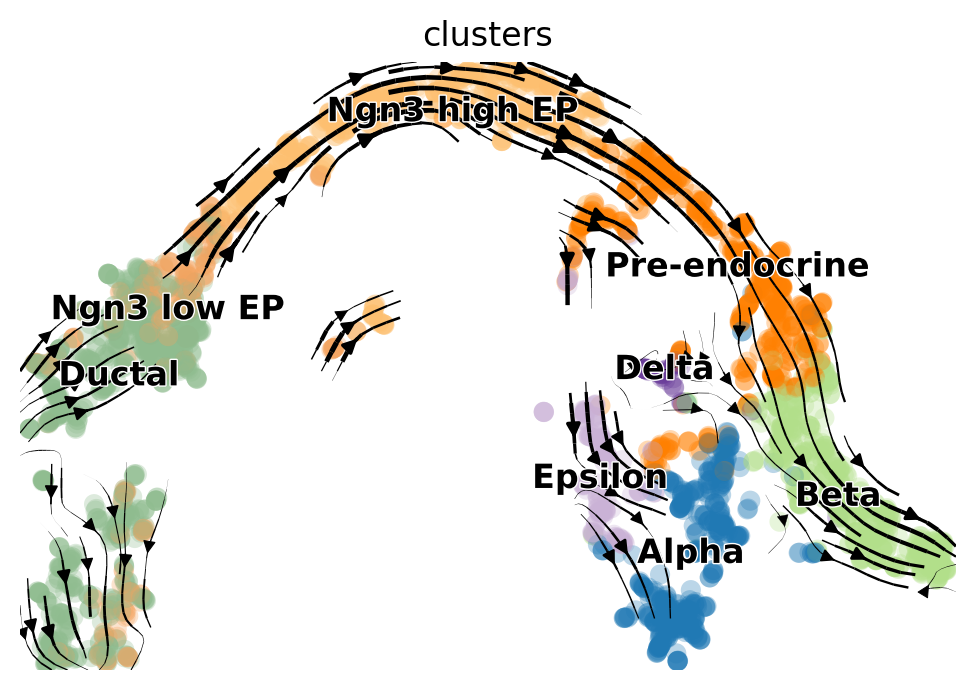

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


29
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


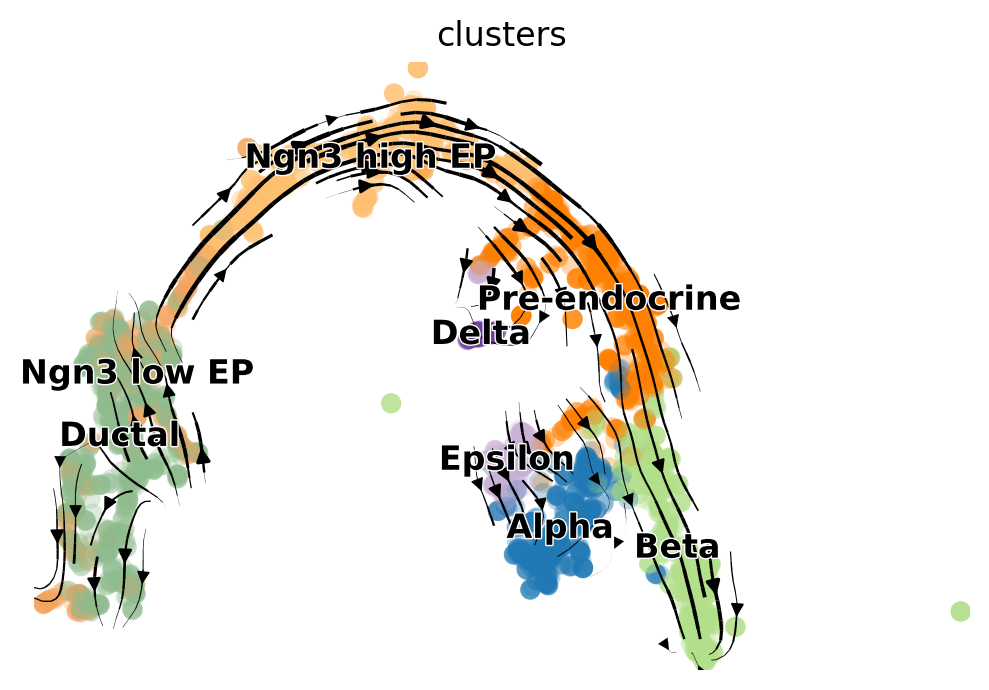

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


30
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


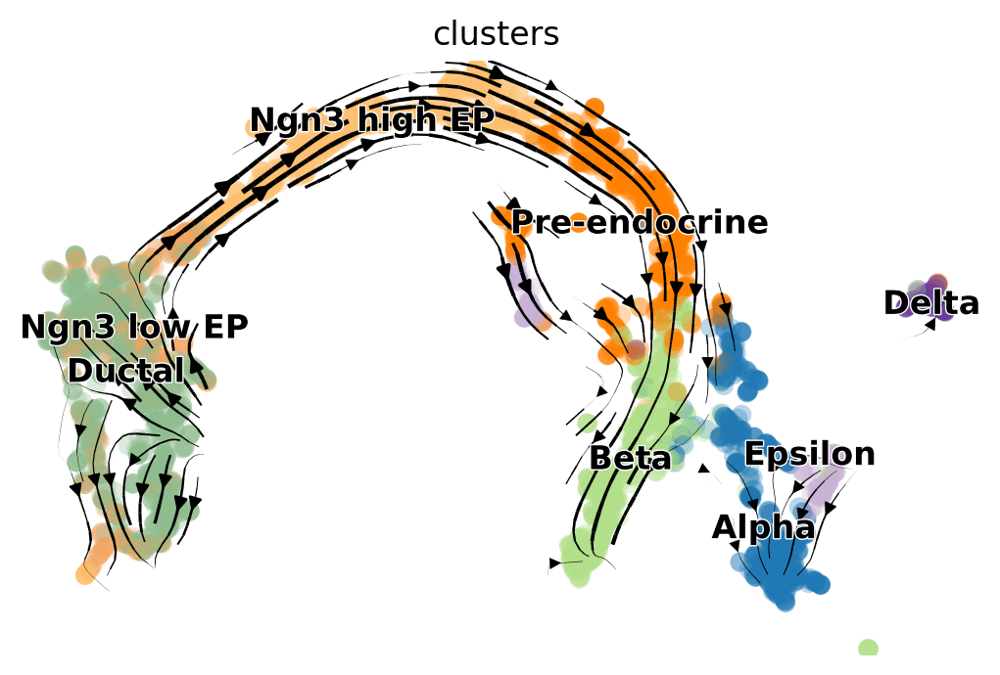

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


31
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


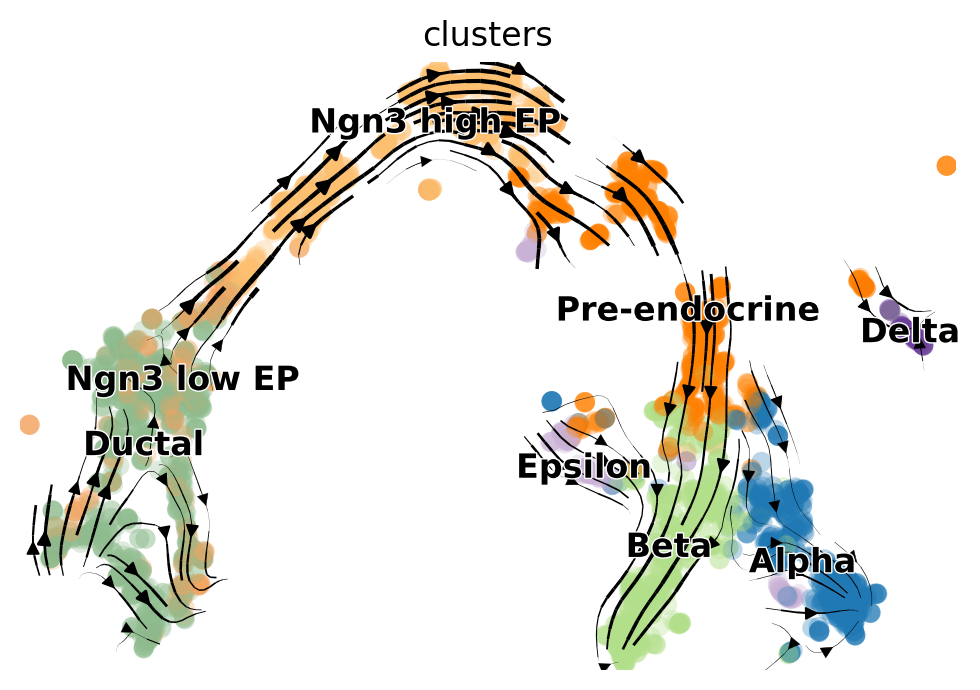

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


32
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


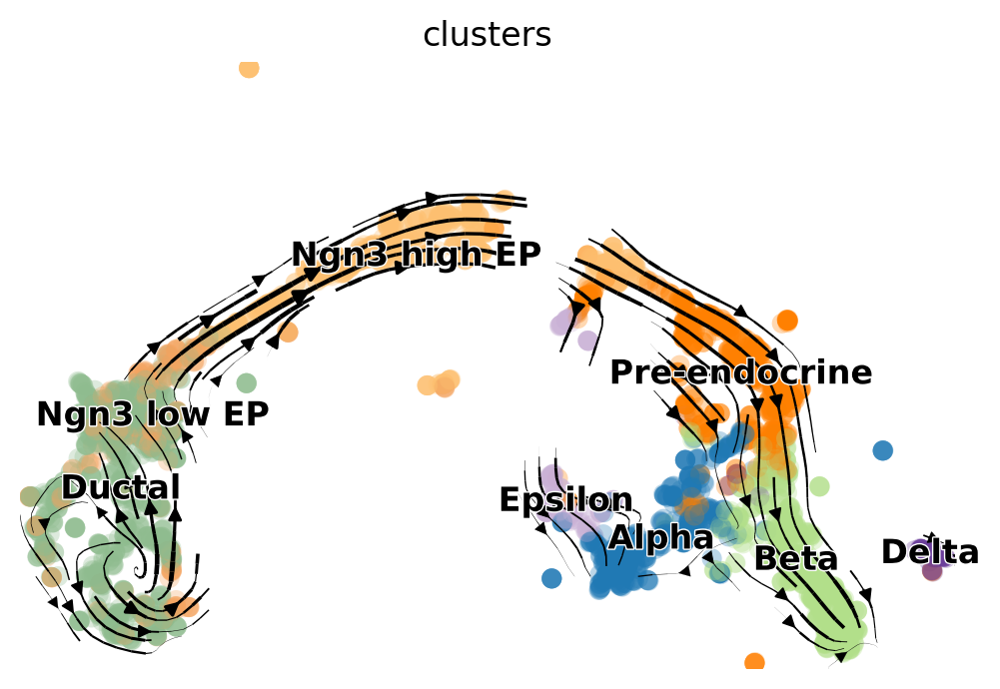

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


33
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


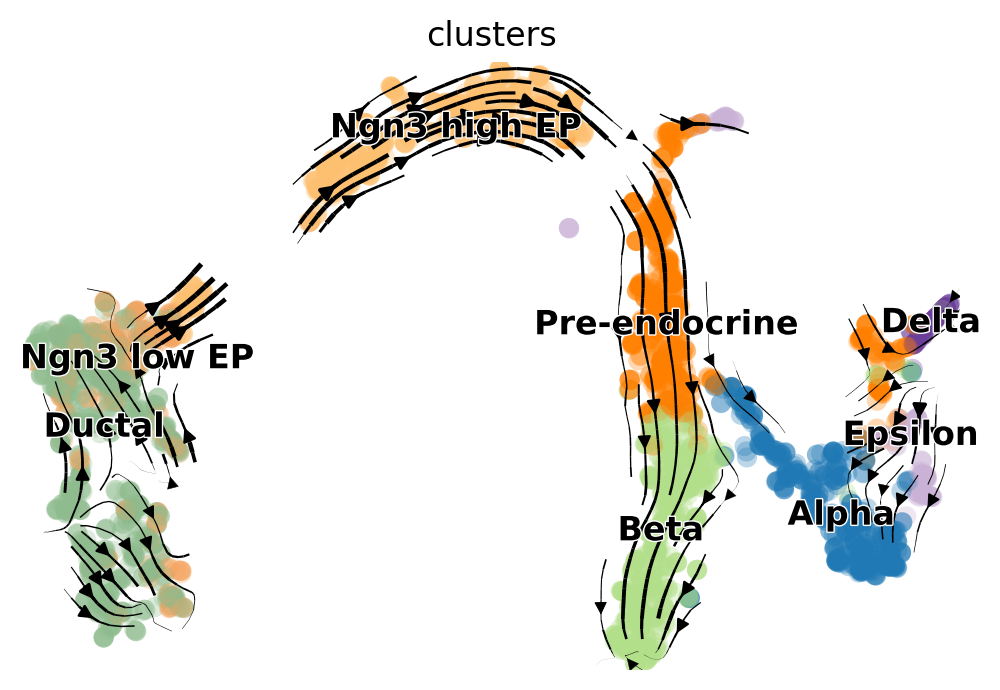

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


34
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


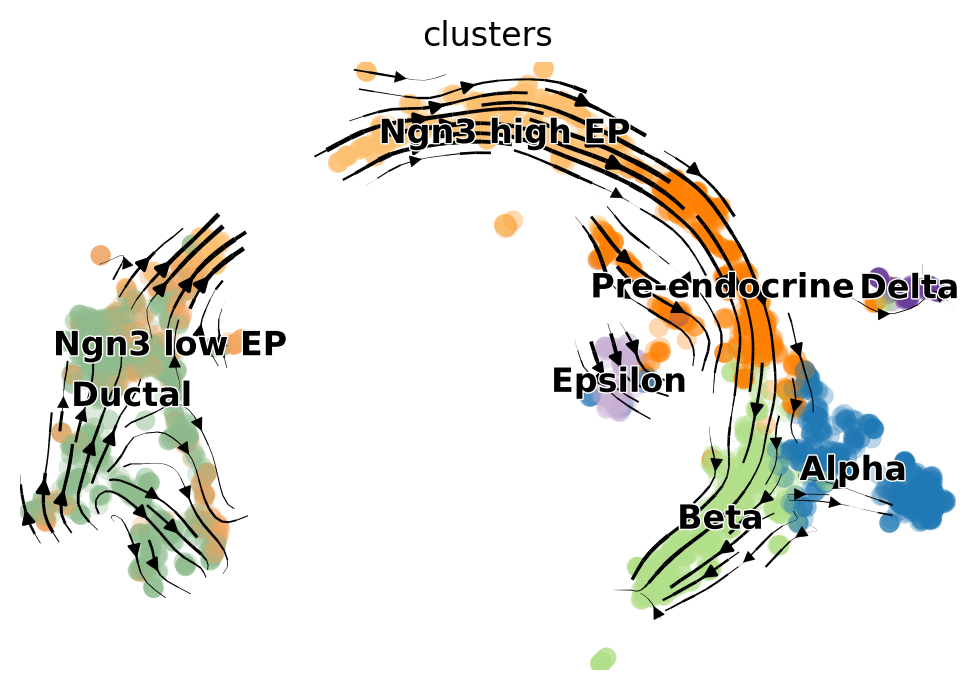

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


35
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


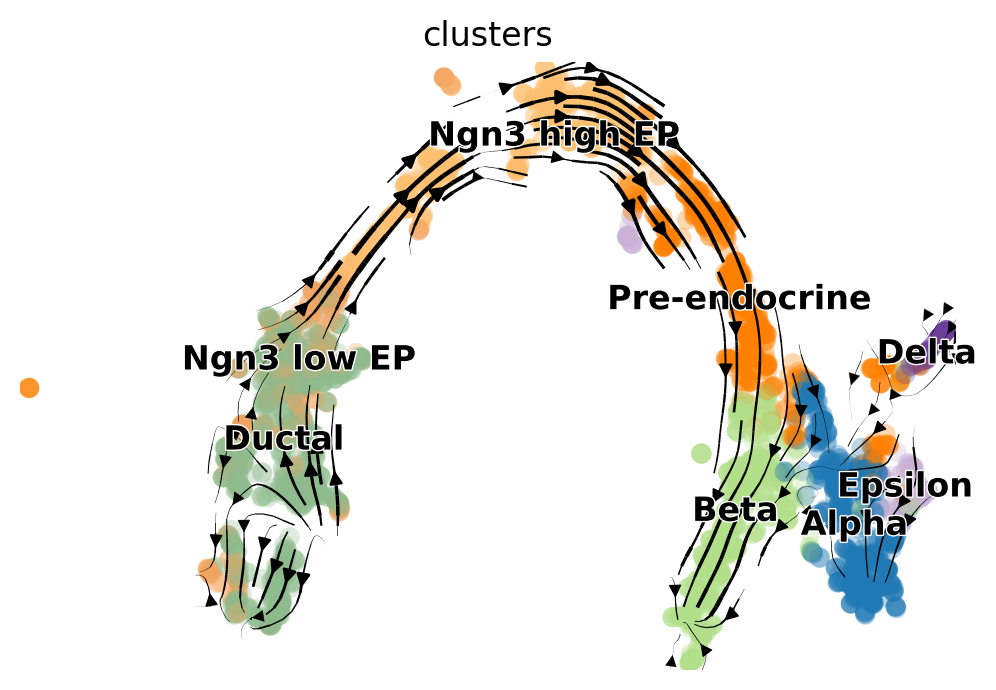

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


36
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


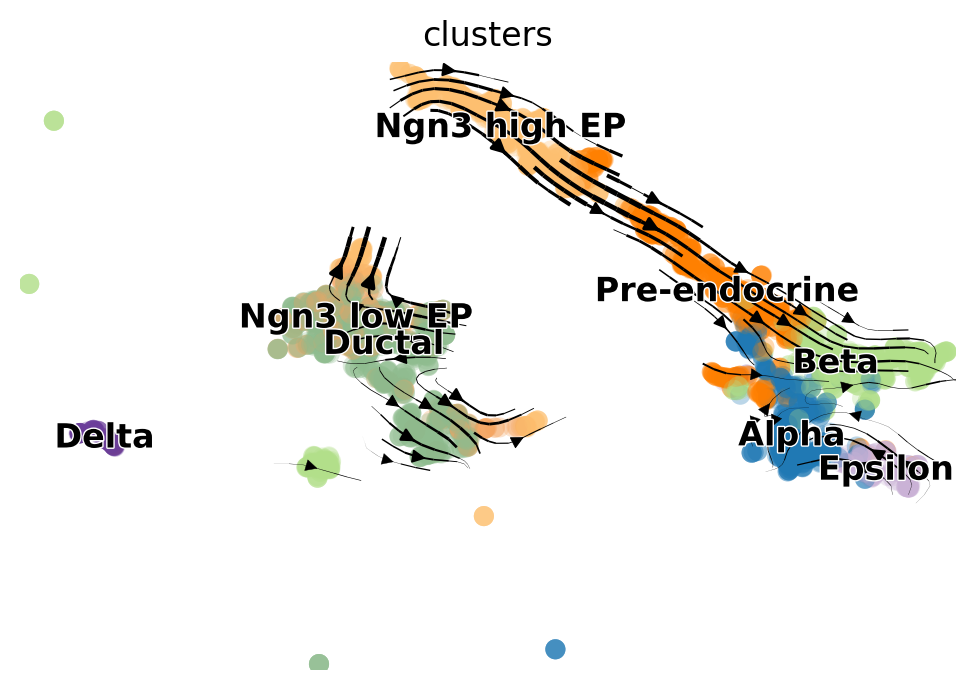

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


37
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


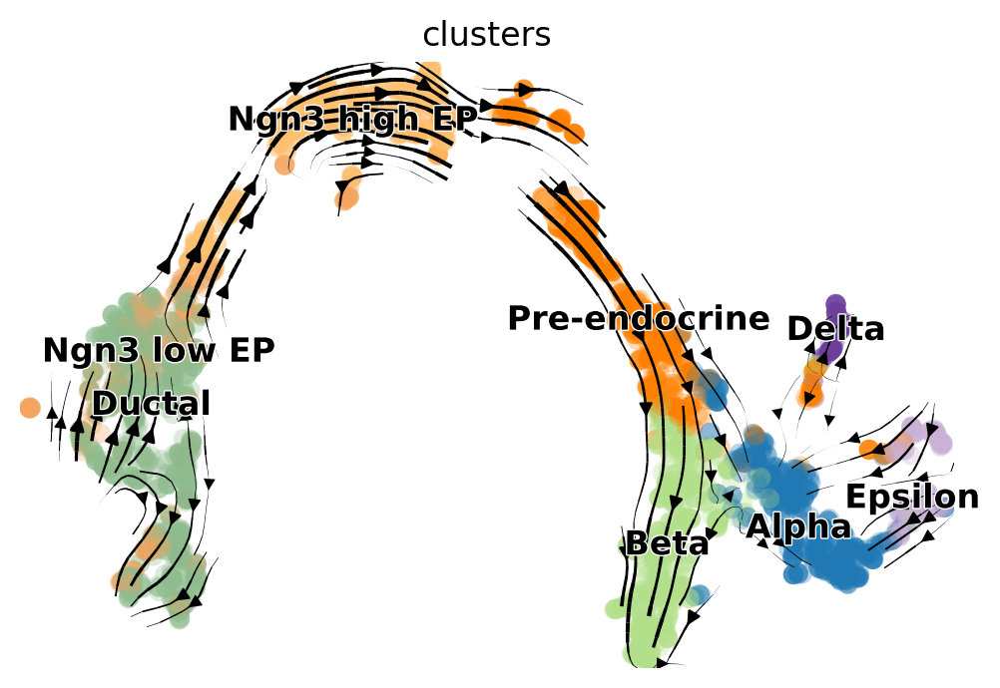

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


38
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


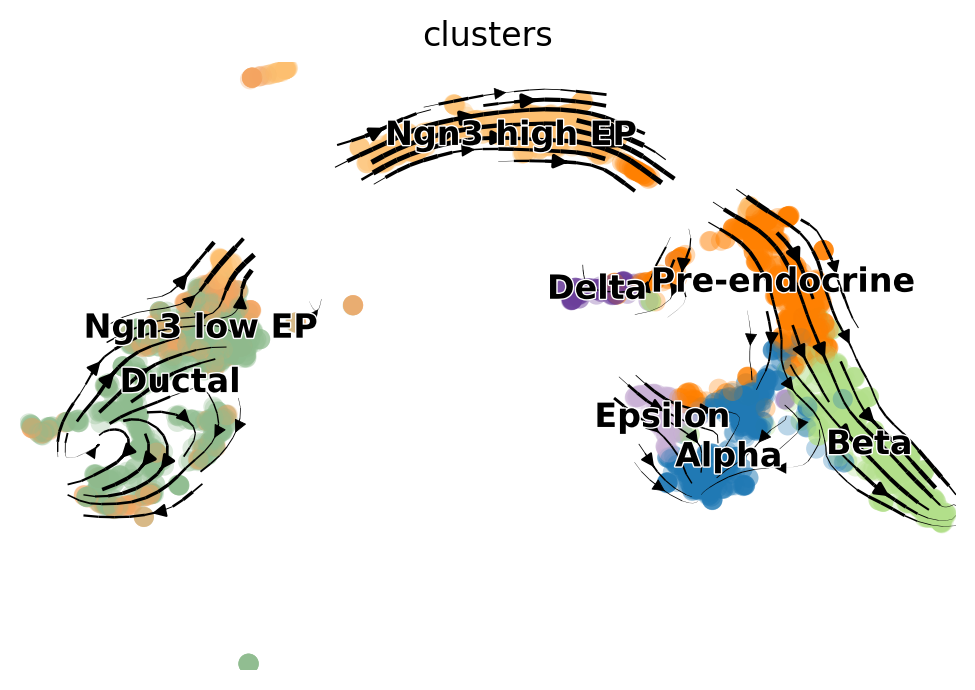

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


39
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


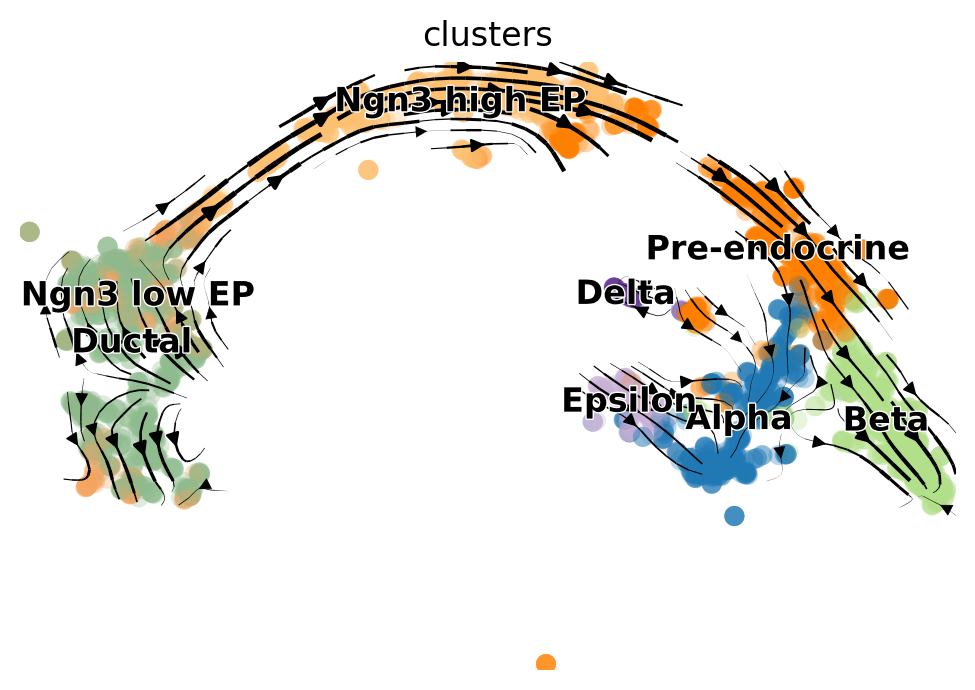

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


40
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


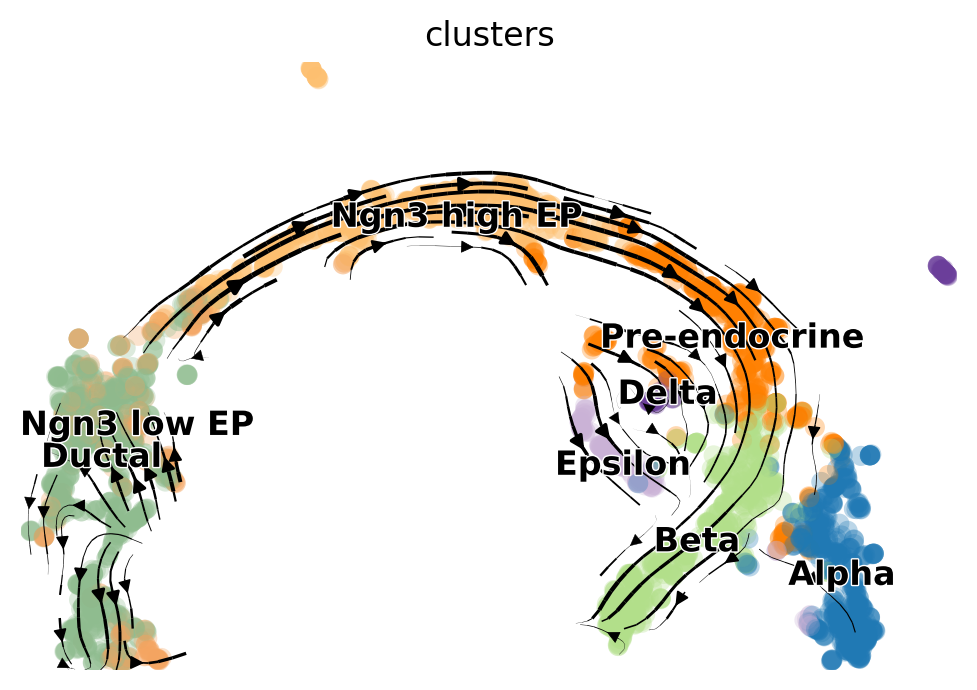

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


41
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


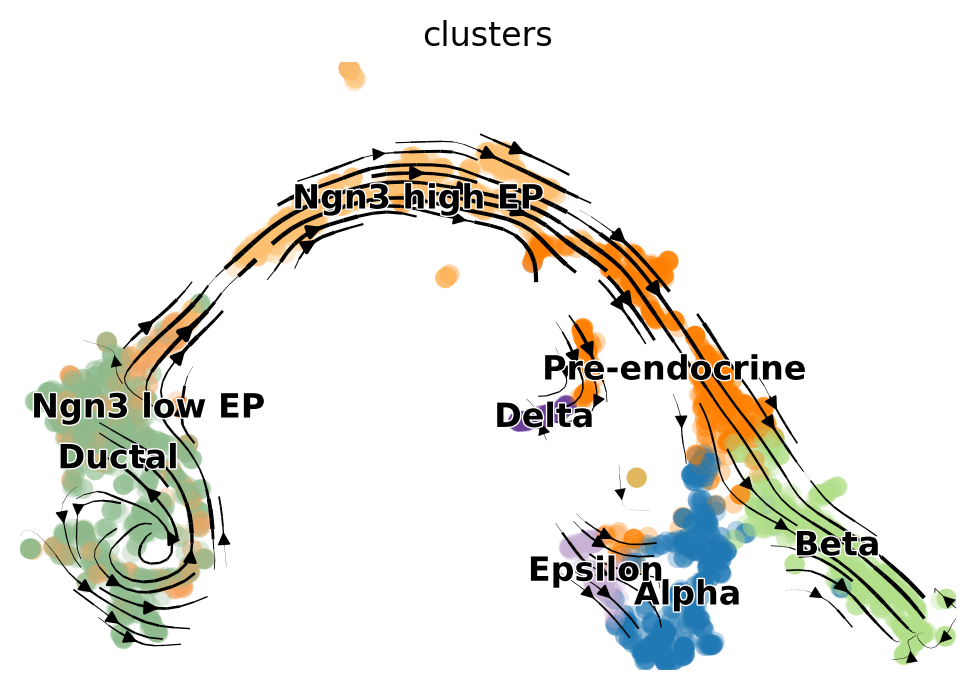

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


42
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


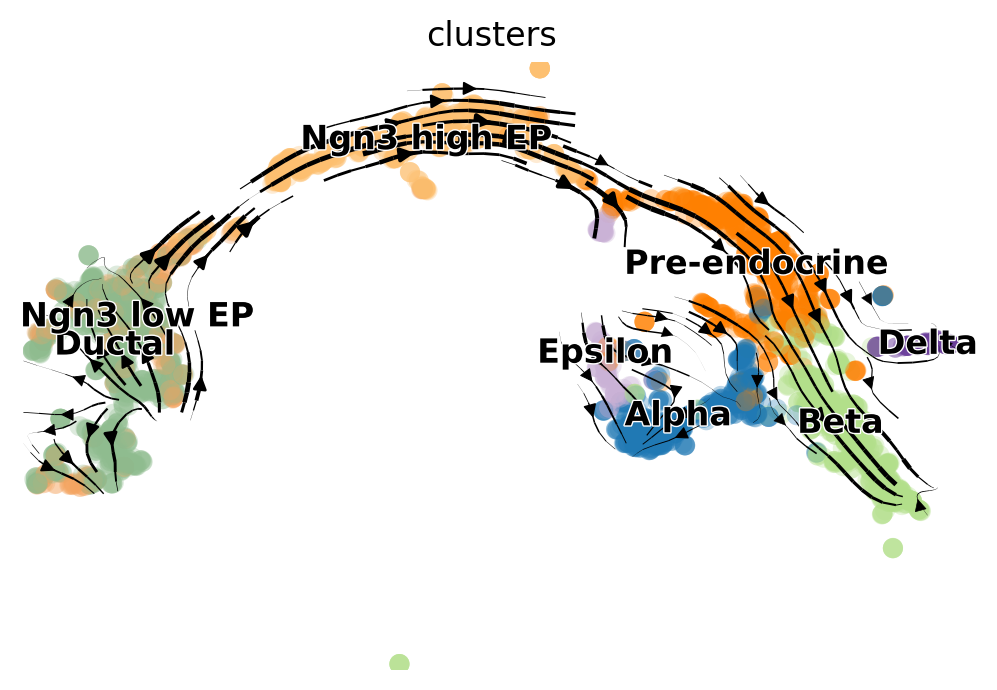

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


43
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


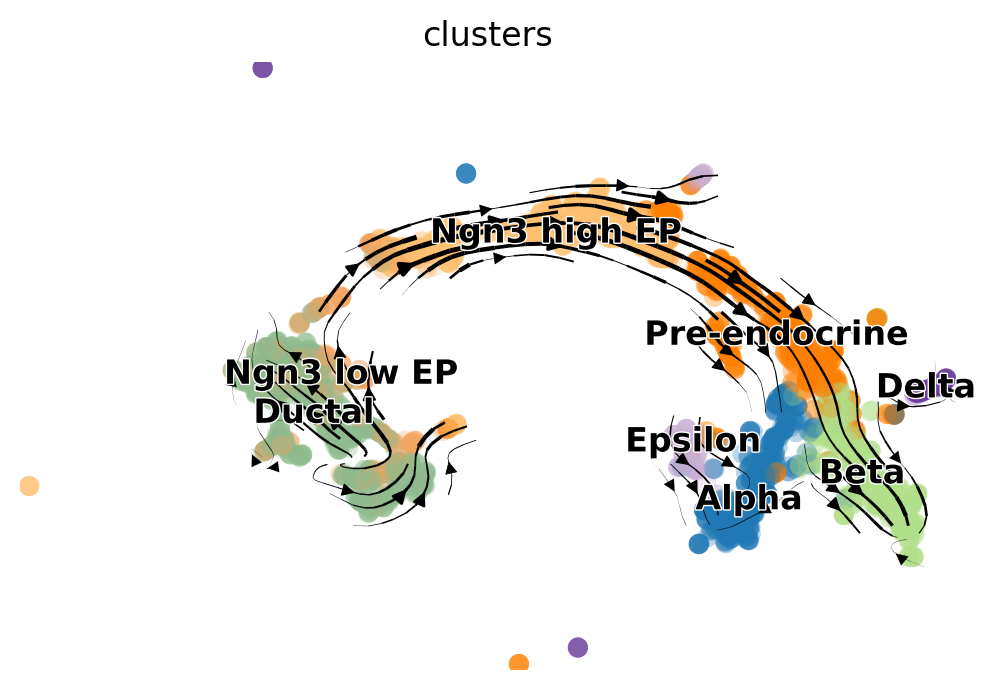

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


44
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


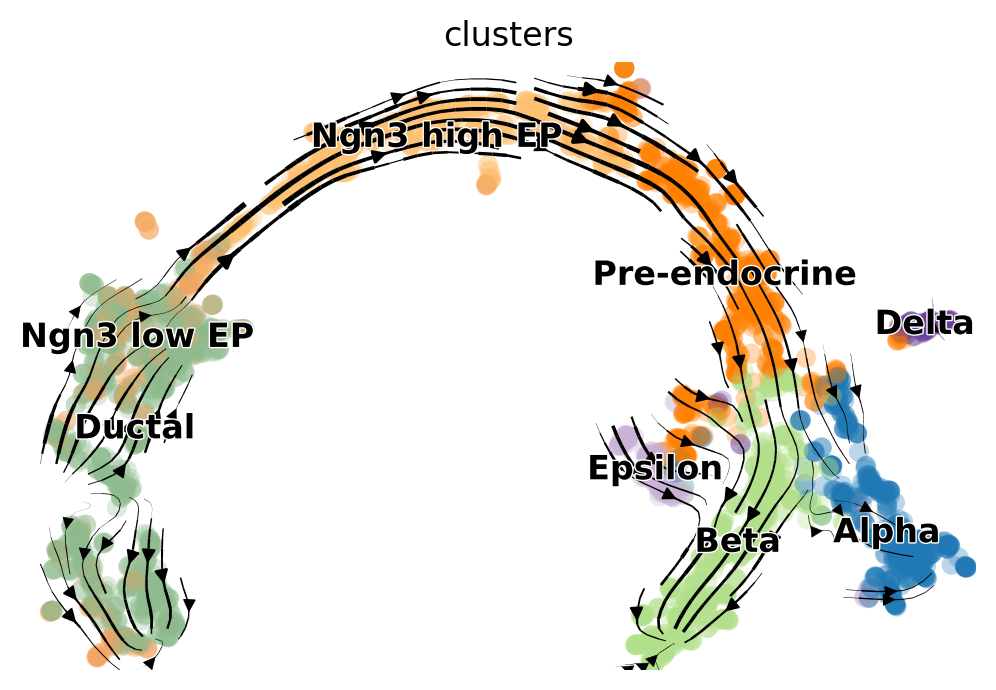

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


45
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


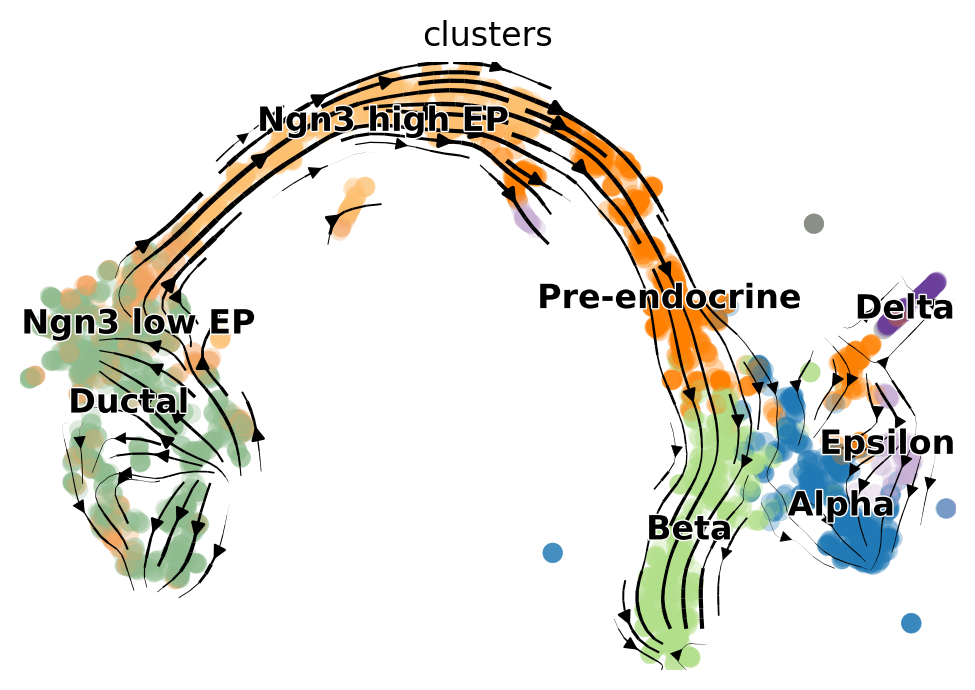

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


46
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


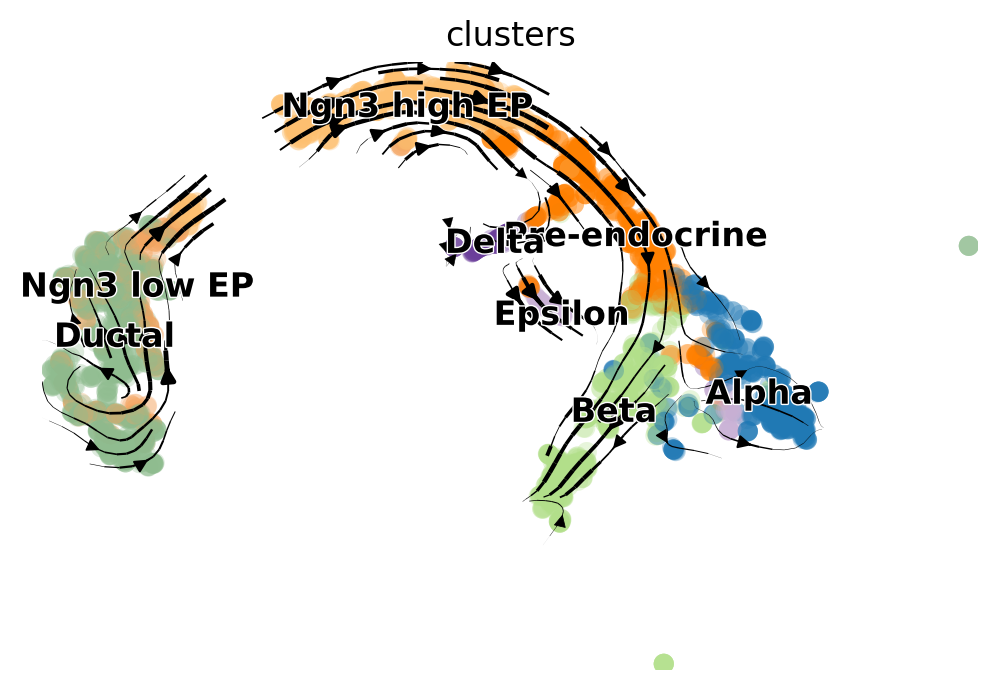

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


47
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


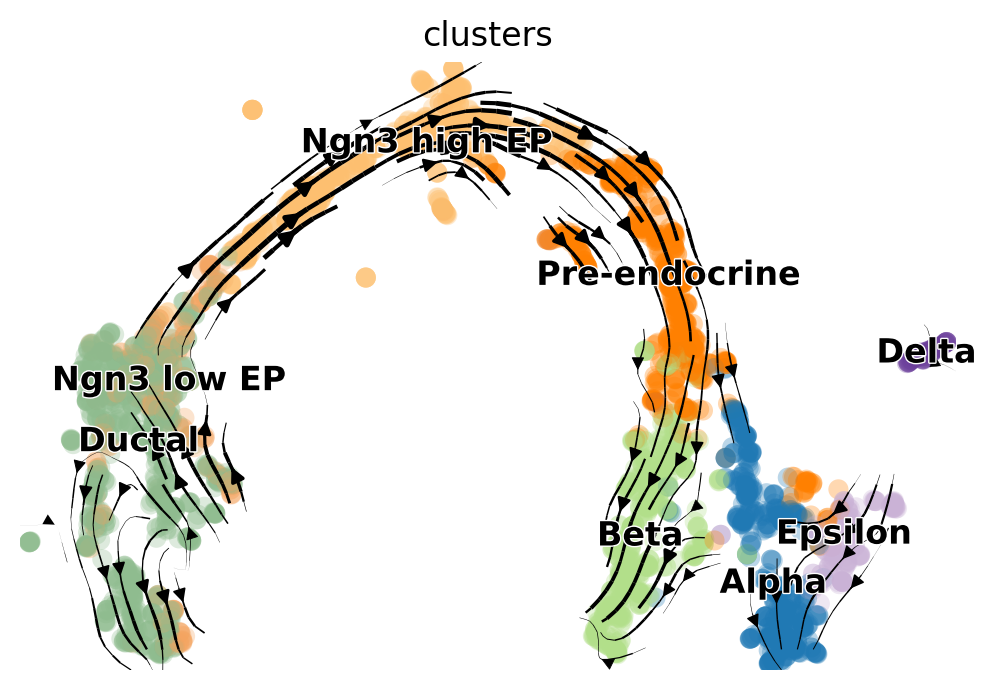

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


48
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


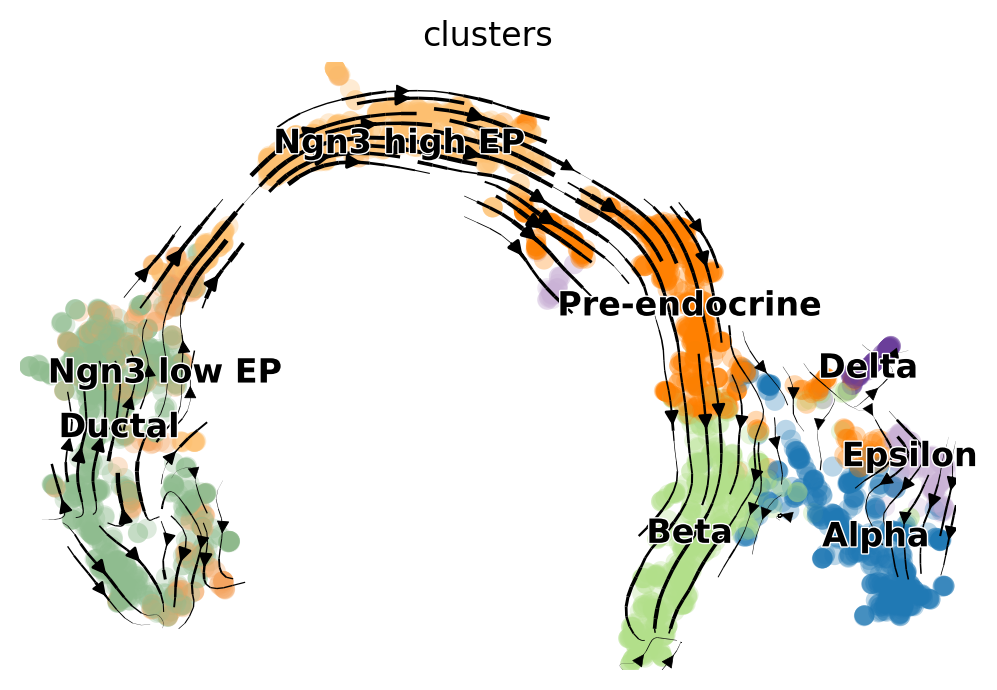

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


49
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


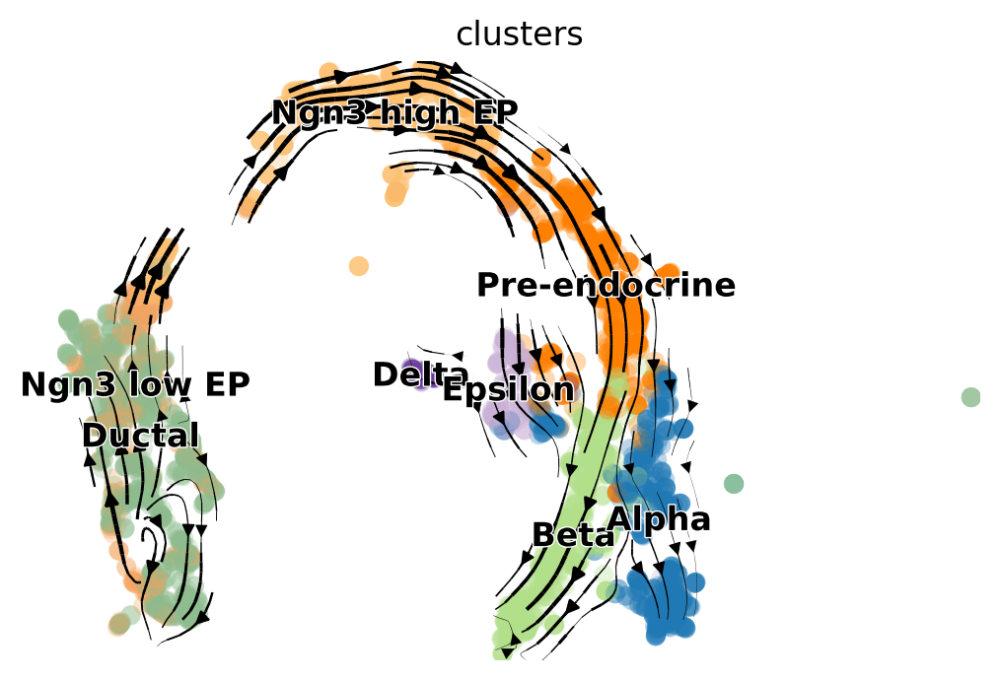

In [50]:
# for b in np.arange(-1,50,1):
#     adata_boot = utils.regenerate_anndata(adata, out, b, "X_umap")
#     if "velocity_umap" in list(adata_boot.obsm.keys()):
#         del adata_boot.obsm["velocity_umap"]
#     print(b)
#     scv.pl.velocity_embedding_stream(adata_boot, basis='umap')

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


0
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


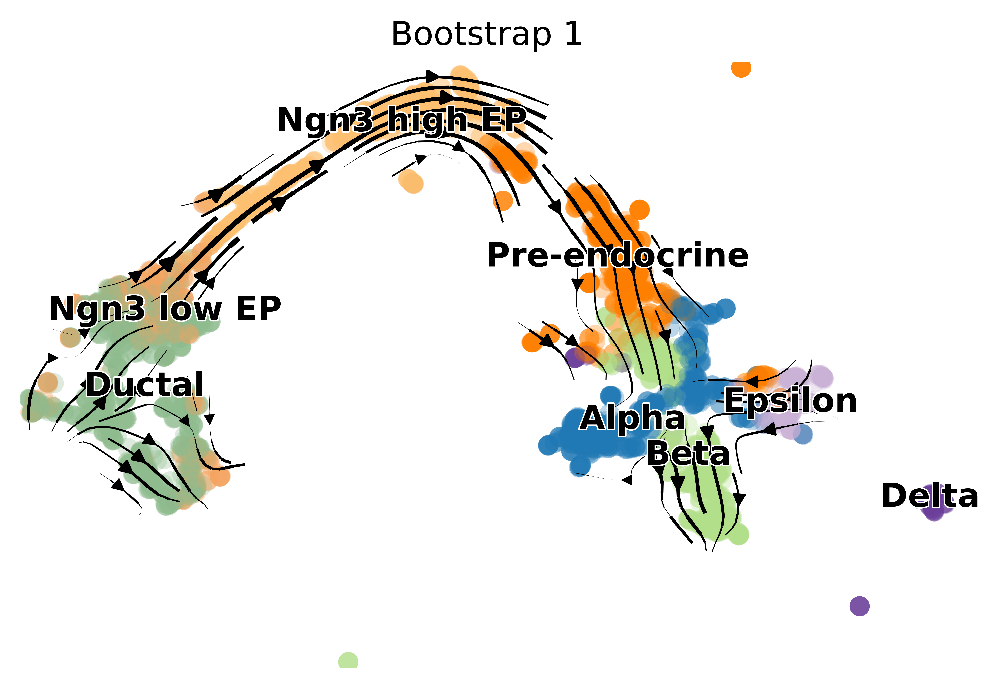

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


8
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


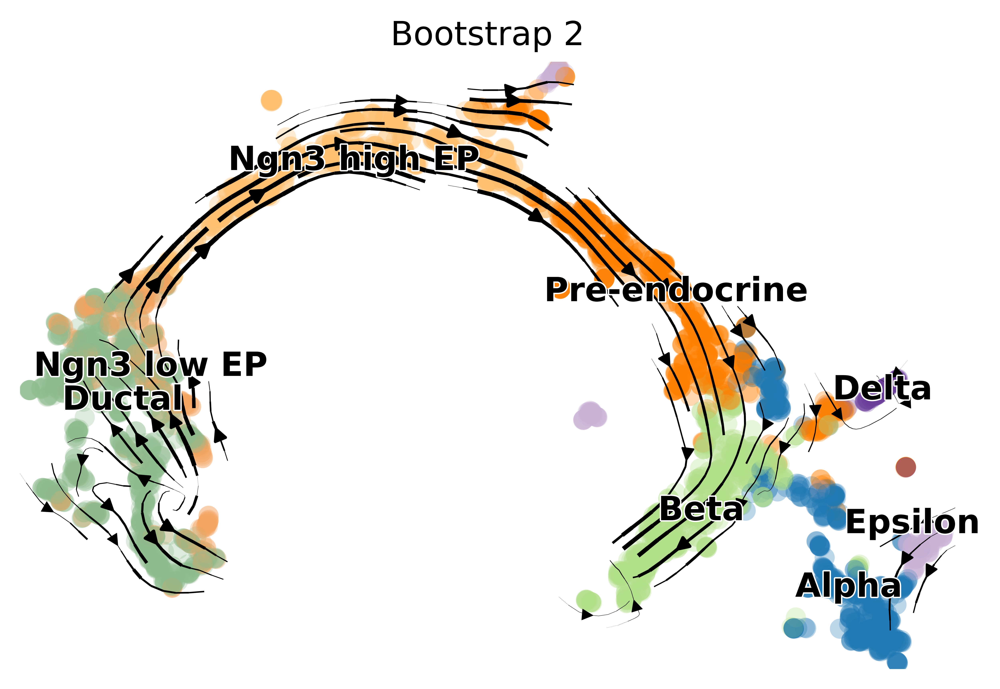

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


42
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


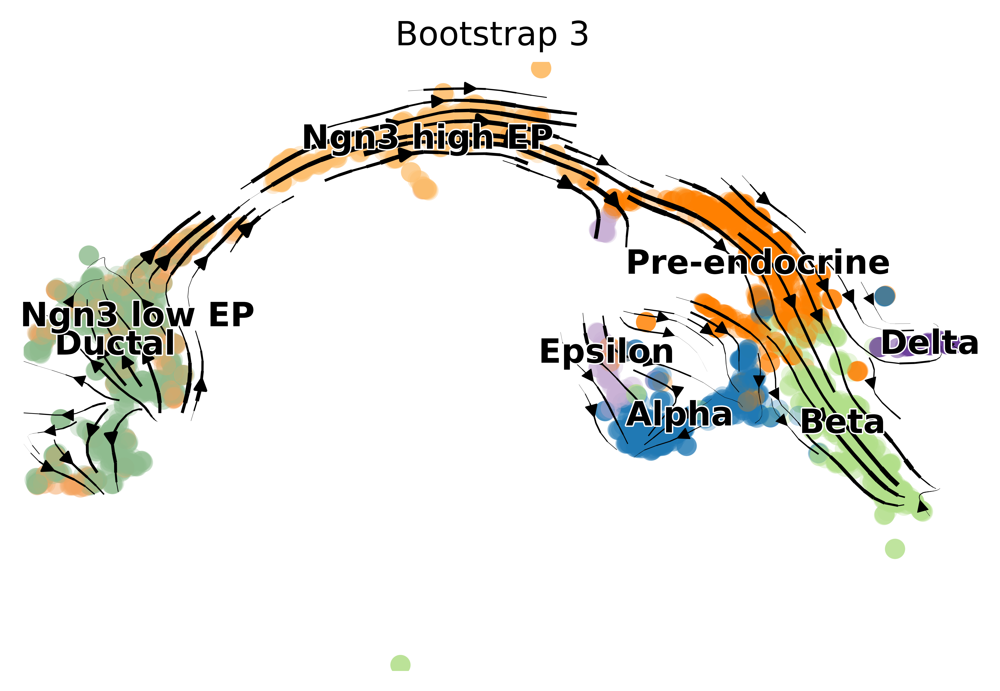

In [89]:
# show velocity maps for a few cases

for i, b in enumerate([0,8,42]):
    adata_boot = utils.regenerate_anndata(adata, out, b, "X_umap")
    if "velocity_umap" in list(adata_boot.obsm.keys()):
        del adata_boot.obsm["velocity_umap"]
    print(b)
    scv.pl.velocity_embedding_stream(adata_boot, basis='umap', dpi=500, title="Bootstrap "+str(i+1))

## Figure 4E and F: Cell lineage tracing

In [138]:
run_search = False
# keep going until a good example is reached:

starting_cell = 4 # init starting cell

counter = 0
counts = [0]

while (len(counts) < 2) or (np.min(counts) < 3) and run_search:
    # re-generate adata and get cell lineage traces
    #starting_cell = starting_cells[counter]
    terminal_states = []

    # collect examples for first of each terminal cluster type
    terminals = []
    lineage_indices = []
    lineage_xs = []
    lineage_ys = []
    adata_boots = []

    for b in np.unique(out["bootstrap_number"]):

        if starting_cell in list(out[out["bootstrap_number"] == b]["original_index"]): # only compute if cell of interest in boot
            adata_boot = utils.regenerate_anndata(adata, out, b, "X_umap")        

            # compute lineages
            starting_idxs = np.where(out[out["bootstrap_number"] == b]["original_index"].values==starting_cell)[0]

            for sidx in starting_idxs:

                # final terminal state
                indices = scv.utils.get_cell_transitions(adata_boot, starting_cell=sidx)
                final_cluster = adata_boot.obs["clusters"][indices[-1]]
                terminal_states.append(final_cluster)

                if final_cluster not in terminals: # update new fate lineage
                    terminals.append(final_cluster)
                    lineage_xs.append(adata_boot.obsm["X_umap"][indices,0])
                    lineage_ys.append(adata_boot.obsm["X_umap"][indices,1])
                    lineage_indices.append(indices)
                    adata_boots.append(adata_boot)

        else:
            continue
    
    states, counts = np.unique(terminal_states, return_counts=True)
    counter += 1

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique,

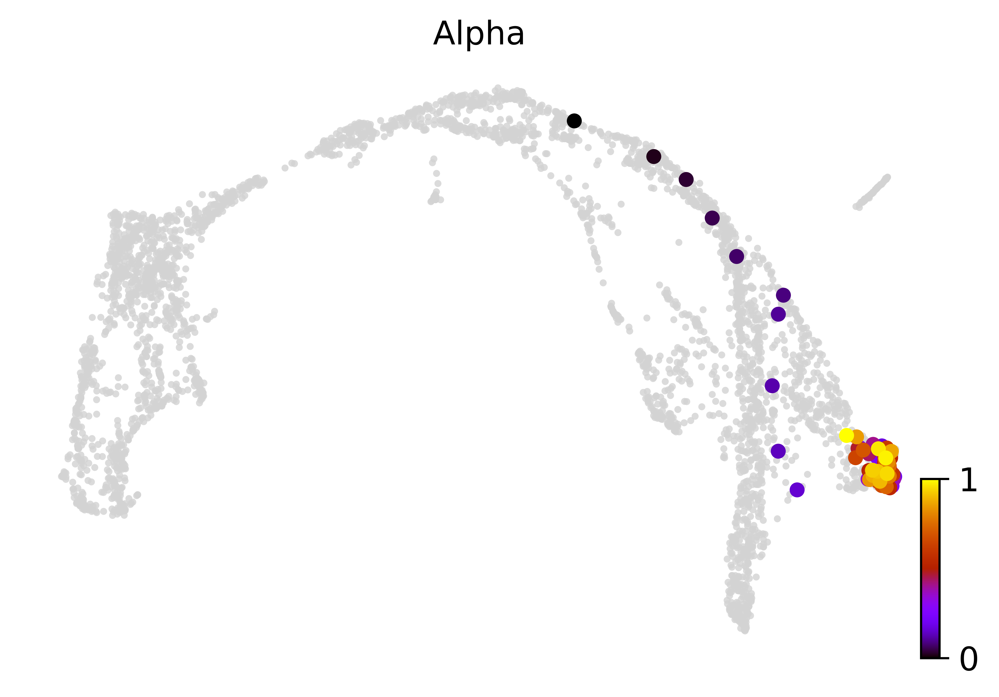

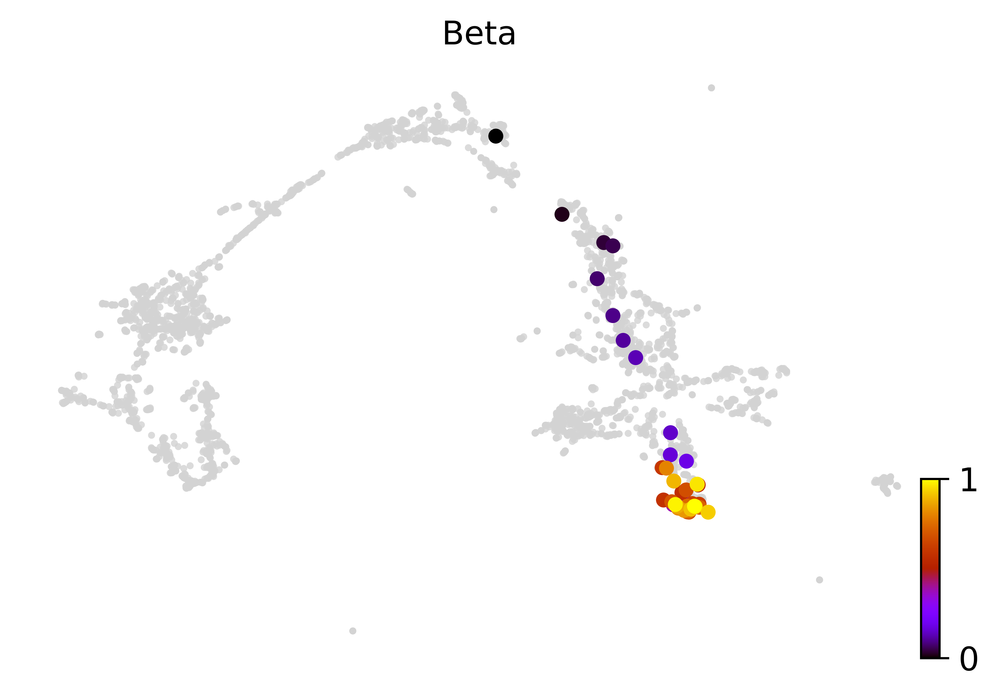

In [139]:
for i, term in enumerate(terminals):
    ax = scv.pl.velocity_graph(adata_boots[i], c='lightgrey', edge_width=.0, show=False, dpi=500)
    scv.pl.scatter(adata_boots[i], x=lineage_xs[i], y=lineage_ys[i], s=120, c='ascending', cmap='gnuplot', ax=ax, title=term, dpi=500)
    if "velocity_umap" in list(adata_boots[i].obsm.keys()):
        del adata_boots[i].obsm["velocity_umap"]
    #scv.pl.velocity_embedding_stream(adata_boots[i], basis='umap', dpi=500)

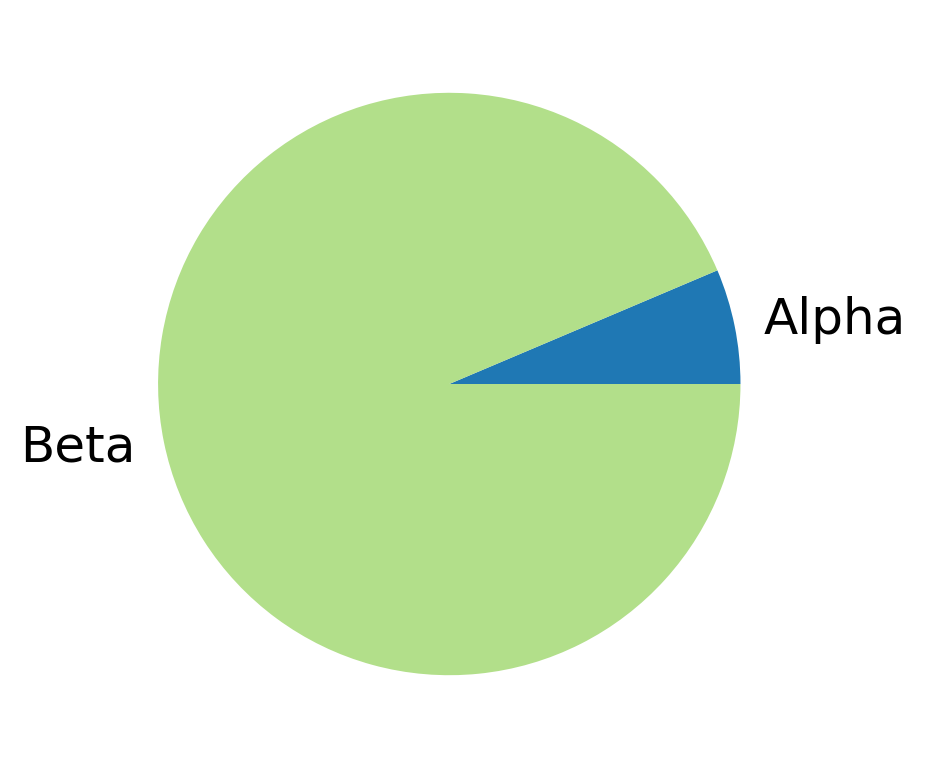

In [140]:
states, counts = np.unique(terminal_states, return_counts=True)

color_dict = {}
for idx, cluster in enumerate(adata.obs['clusters'].cat.categories):
    color_dict[cluster] = adata.uns['clusters_colors'][idx]
colors = [color_dict[key] for key in states]

plt.pie(counts, labels=states, colors=colors, textprops={'fontsize': 18})
plt.tight_layout()
plt.savefig("plots/rna_velocity/pie_start4.png", dpi=500)
plt.show()

In [143]:
# Repeat for a different starting cell

run_search = False

starting_cell = 20

counter = 0
counts = [0]

while (len(counts) < 2) or (np.min(counts) < 3) and run_search:
    # re-generate adata and get cell lineage traces
    #starting_cell = starting_cells[counter]
    terminal_states = []

    # collect examples for first of each terminal cluster type
    terminals = []
    lineage_indices = []
    lineage_xs = []
    lineage_ys = []
    adata_boots = []

    for b in np.unique(out["bootstrap_number"]):

        if starting_cell in list(out[out["bootstrap_number"] == b]["original_index"]): # only compute if cell of interest in boot
            adata_boot = utils.regenerate_anndata(adata, out, b, "X_umap")        

            # compute lineages
            starting_idxs = np.where(out[out["bootstrap_number"] == b]["original_index"].values==starting_cell)[0]

            for sidx in starting_idxs:

                # final terminal state
                indices = scv.utils.get_cell_transitions(adata_boot, starting_cell=sidx)
                final_cluster = adata_boot.obs["clusters"][indices[-1]]
                terminal_states.append(final_cluster)

                if final_cluster not in terminals: # update new fate lineage
                    terminals.append(final_cluster)
                    lineage_xs.append(adata_boot.obsm["X_umap"][indices,0])
                    lineage_ys.append(adata_boot.obsm["X_umap"][indices,1])
                    lineage_indices.append(indices)
                    adata_boots.append(adata_boot)

        else:
            continue
    
    states, counts = np.unique(terminal_states, return_counts=True)
    counter += 1

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique,

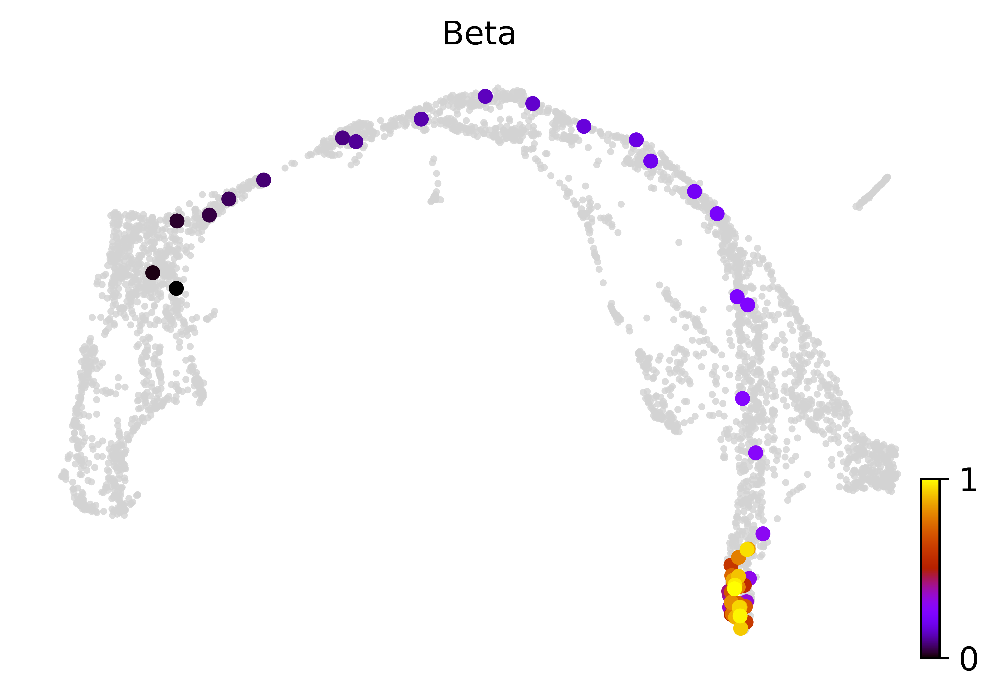

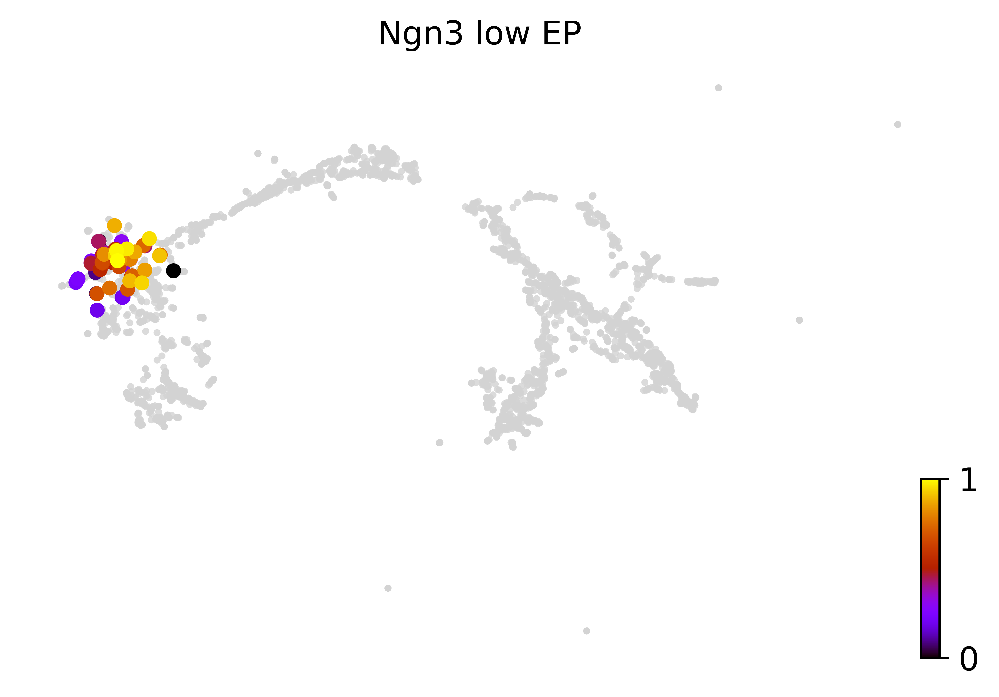

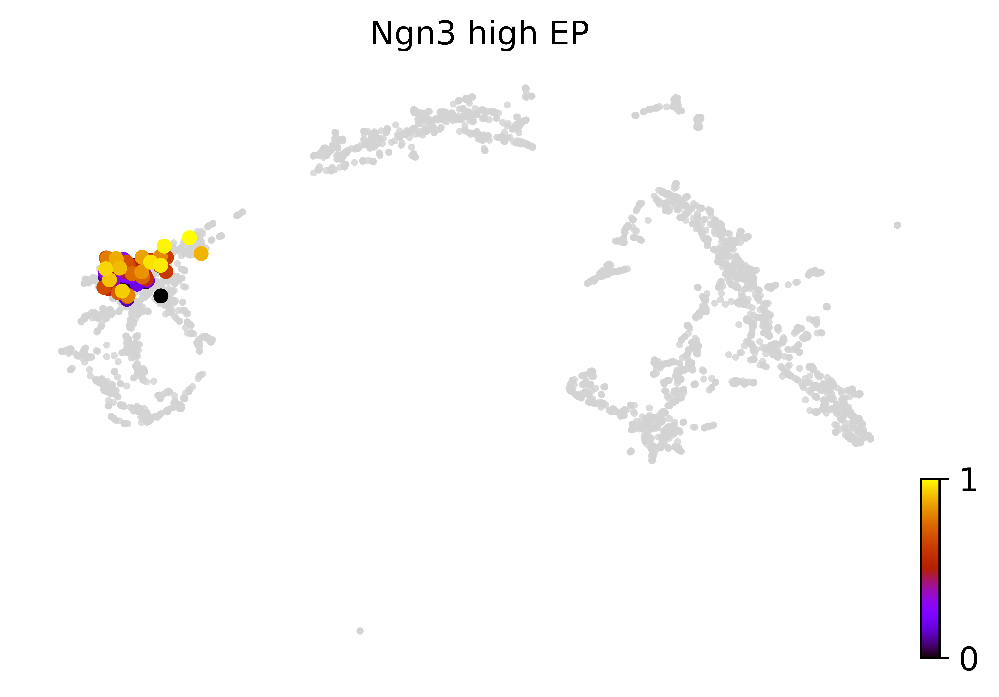

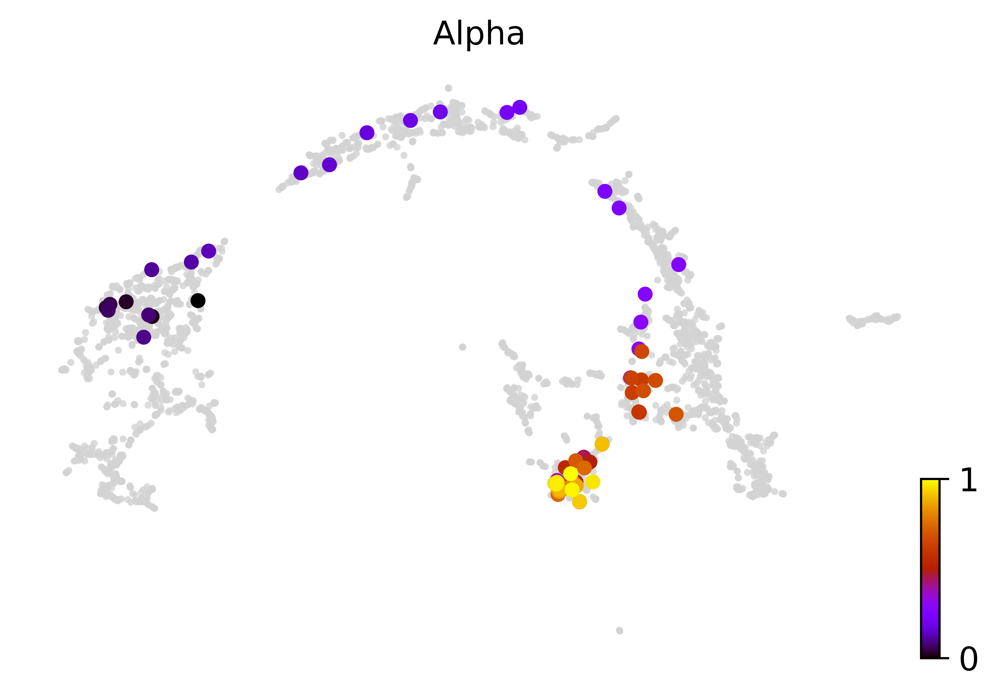

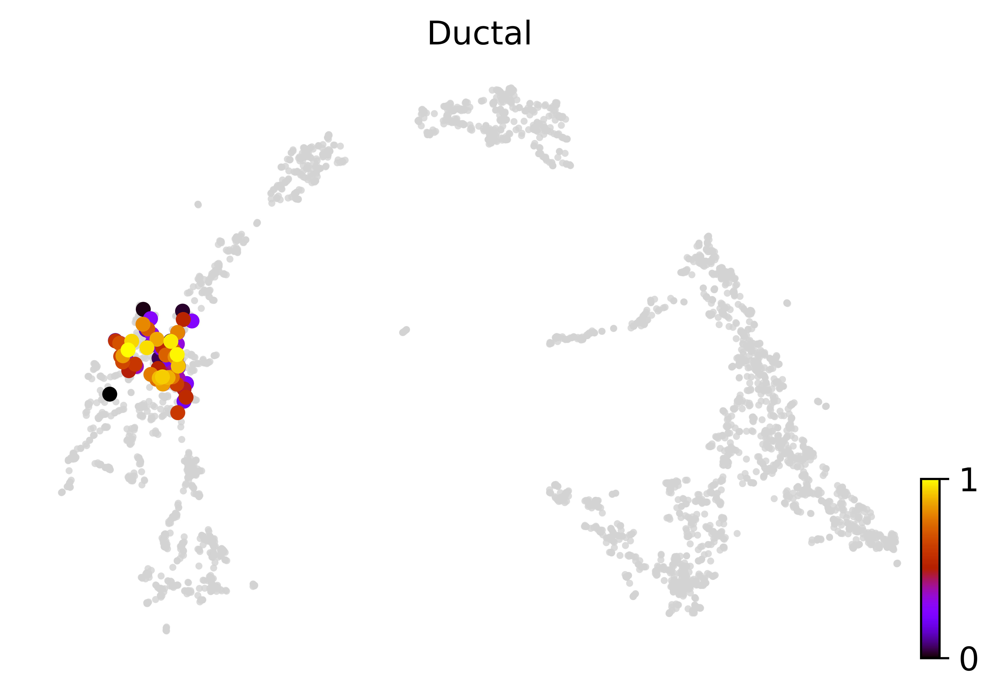

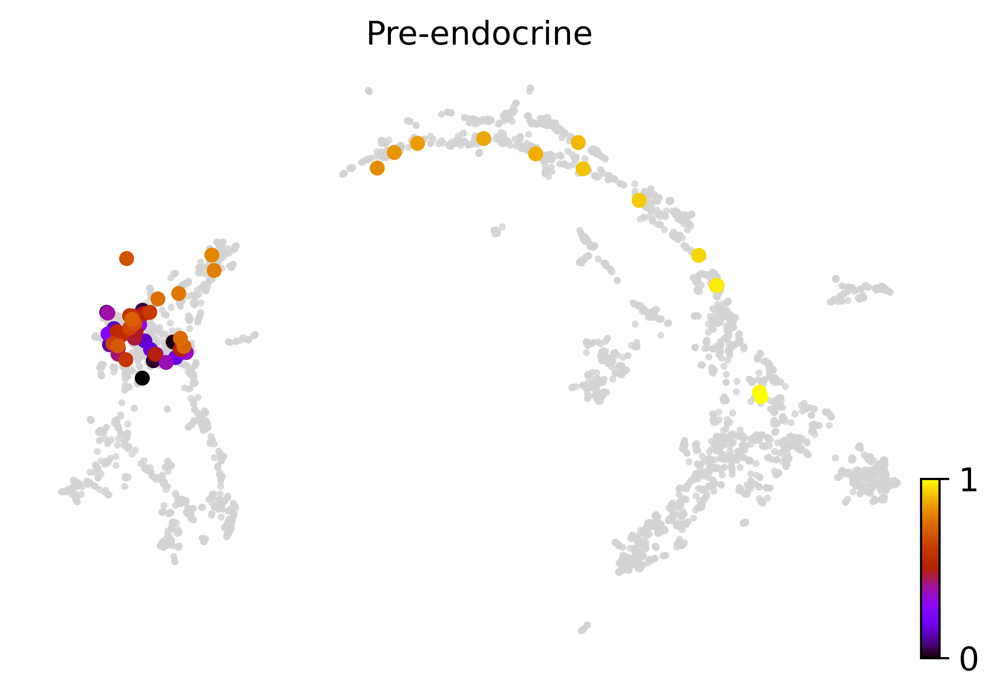

In [144]:
for i, term in enumerate(terminals):
    ax = scv.pl.velocity_graph(adata_boots[i], c='lightgrey', edge_width=.0, show=False, dpi=500)
    scv.pl.scatter(adata_boots[i], x=lineage_xs[i], y=lineage_ys[i], s=120, c='ascending', cmap='gnuplot', ax=ax, title=term, dpi=500)
    if "velocity_umap" in list(adata_boots[i].obsm.keys()):
        del adata_boots[i].obsm["velocity_umap"]
    #scv.pl.velocity_embedding_stream(adata_boots[i], basis='umap', dpi=500)

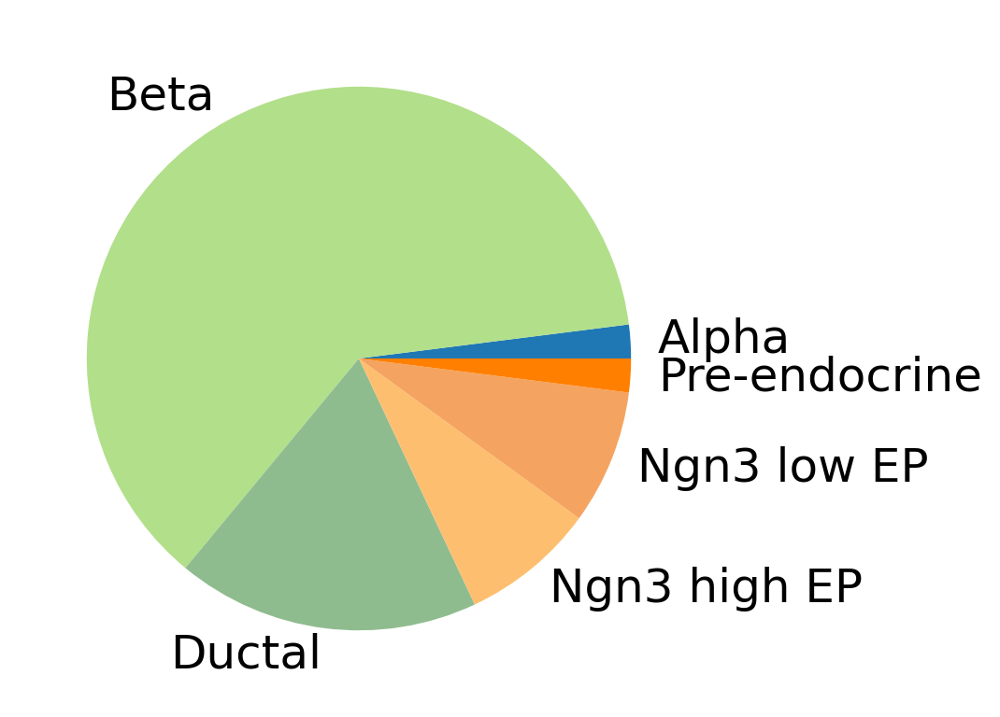

In [145]:
states, counts = np.unique(terminal_states, return_counts=True)

color_dict = {}
for idx, cluster in enumerate(adata.obs['clusters'].cat.categories):
    color_dict[cluster] = adata.uns['clusters_colors'][idx]
colors = [color_dict[key] for key in states]

plt.pie(counts, labels=states, colors=colors, textprops={'fontsize': 18})
plt.tight_layout()
plt.savefig("plots/rna_velocity/pie_start20.png", dpi=500)
plt.show()

## Figure 4C and D: Pseudotime variation

In [ ]:
# compute all pseudotimes
pseudotime_dict = {}

for b in np.unique(out["bootstrap_number"]):

    adata_boot = utils.regenerate_anndata(adata, out, b, "X_umap")
    sc.pp.neighbors(adata_boot)

    # compute pseudotimes
    scv.tl.velocity_pseudotime(adata_boot)
    
    # boot idxs
    boot_idxs = out[out["bootstrap_number"] == b]["original_index"].values
    
    for pi, key in enumerate(boot_idxs):
        pt = adata_boot.obs['velocity_pseudotime'].values[pi]
        if str(key) not in pseudotime_dict:
            pseudotime_dict[str(key)] = [pt]
        else:
            pseudotime_dict[str(key)].append(pt)
            
# save
a_file = open("outputs/rna_velocity/pancreas_pseudotime_dict.pkl", "wb")
pickle.dump(pseudotime_dict, a_file)
a_file.close()

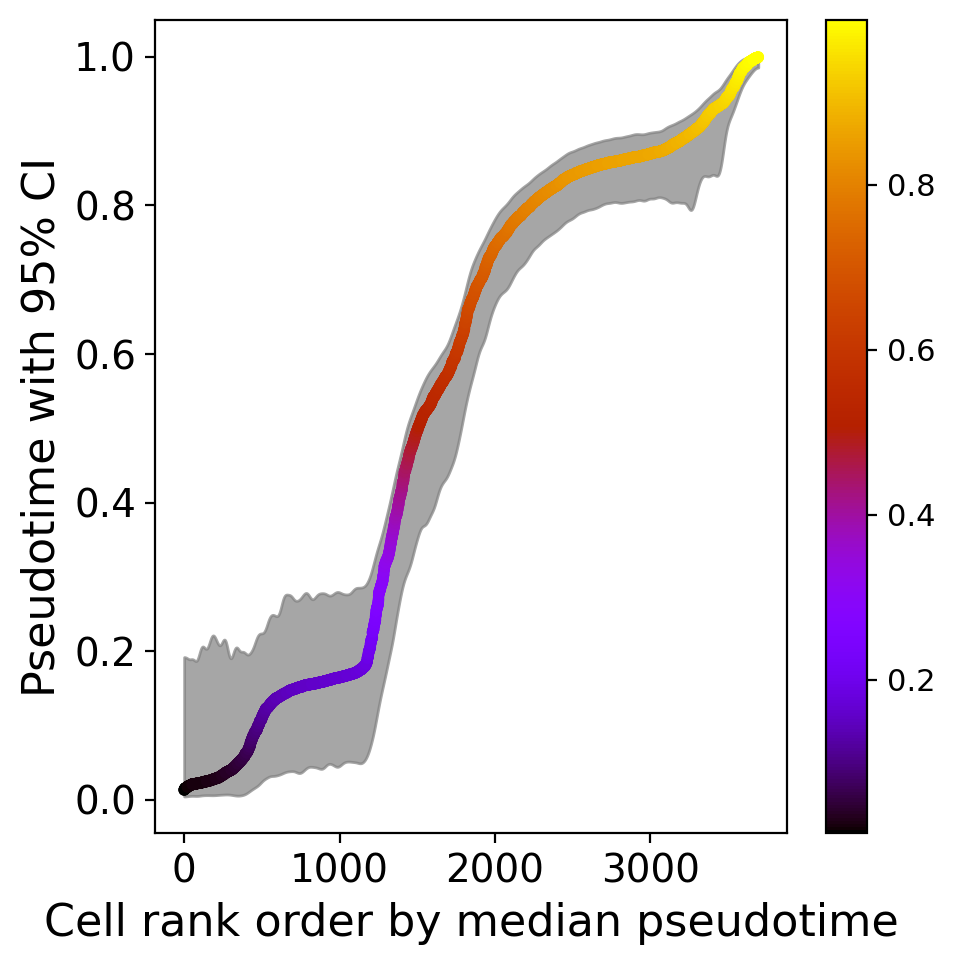

In [31]:
a_file = open("outputs/rna_velocity/pancreas_pseudotime_dict.pkl", "rb")
pseudotime_dict = pickle.load(a_file)
a_file.close()

# compute median and spread of pseudotimes
quartiles1 = []
quartiles3 = []
medians = []
variances_pseudotimes = []

for key in pseudotime_dict.keys():
    vals = pseudotime_dict[str(key)]
    medians.append(np.nanmedian(vals))
    quartiles1.append(np.nanpercentile(vals, 2.5))
    quartiles3.append(np.nanpercentile(vals, 97.5))
    variances_pseudotimes.append(np.nanvar(vals))

# sort
quartiles1 = [x for _, x in sorted(zip(medians, quartiles1))]
quartiles3 = [x for _, x in sorted(zip(medians, quartiles3))]
medians = sorted(medians)

# smoothen
upper = gaussian_filter1d(quartiles3, sigma=20)
lower = gaussian_filter1d(quartiles1, sigma=20)

    
# make plot
plt.figure(figsize=(5,5))
ax = sns.lineplot(np.arange(len(medians)), medians, linewidth=0)
ax.fill_between(np.arange(len(medians)), lower, upper, alpha=0.7, color='0.5')
ax.set_ylabel("Pseudotime with 95% CI", fontsize=16)
ax.set_xlabel("Cell rank order by median pseudotime", fontsize=16)
plt.scatter(np.arange(len(medians)), medians, marker='o', c=medians, cmap='gnuplot', s=10) 
plt.colorbar()
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.tight_layout()
plt.savefig("plots/rna_velocity/pseudotime_CIs.png", dpi=500)
plt.show()

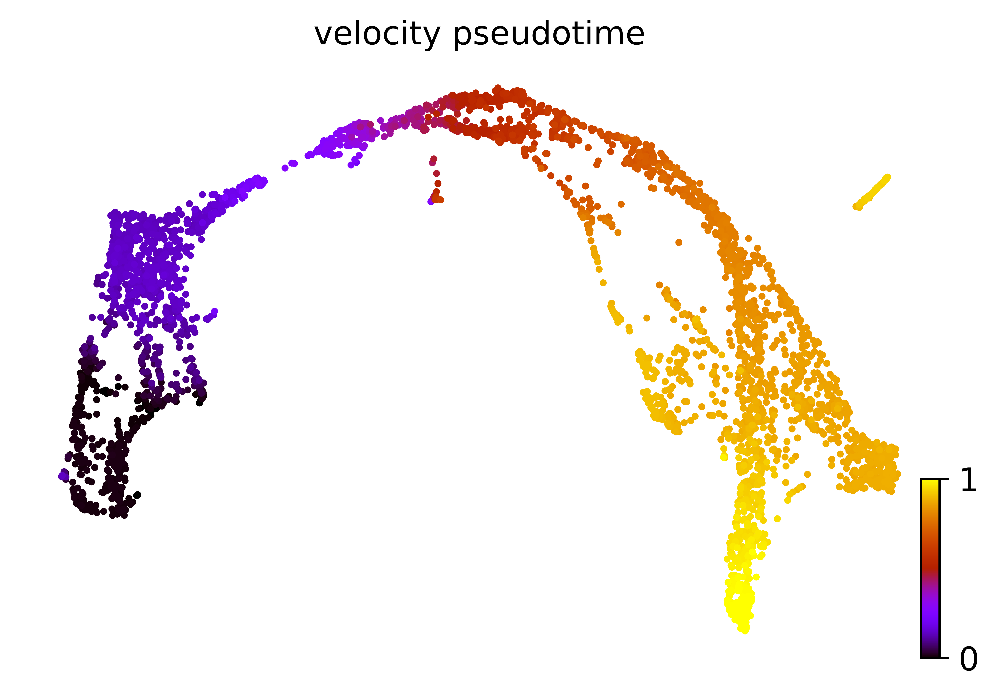

In [186]:
# visualize pseudotime on the UMAP

scv.tl.velocity_pseudotime(adata)
scv.pl.scatter(adata, color='velocity_pseudotime', color_map='gnuplot', dpi=500, title="Velocity Pseudotime")